In [15]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

# Read csv file into a pandas dataframe
df1 = pd.read_csv('../data/accidents_2009_to_2011.csv')



In [16]:
df2 = pd.read_csv('../data/accidents_2012_to_2014.csv')

/opt/anaconda3/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3146: DtypeWarning: Columns (31) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [17]:
df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 469442 entries, 0 to 469441
Data columns (total 33 columns):
 #   Column                                       Non-Null Count   Dtype  
---  ------                                       --------------   -----  
 0   Accident_Index                               469442 non-null  object 
 1   Location_Easting_OSGR                        469442 non-null  int64  
 2   Location_Northing_OSGR                       469442 non-null  int64  
 3   Longitude                                    469442 non-null  float64
 4   Latitude                                     469442 non-null  float64
 5   Police_Force                                 469442 non-null  int64  
 6   Accident_Severity                            469442 non-null  int64  
 7   Number_of_Vehicles                           469442 non-null  int64  
 8   Number_of_Casualties                         469442 non-null  int64  
 9   Date                                         469442 non-nul

In [18]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 464697 entries, 0 to 464696
Data columns (total 33 columns):
 #   Column                                       Non-Null Count   Dtype  
---  ------                                       --------------   -----  
 0   Accident_Index                               464697 non-null  object 
 1   Location_Easting_OSGR                        464697 non-null  int64  
 2   Location_Northing_OSGR                       464697 non-null  int64  
 3   Longitude                                    464697 non-null  float64
 4   Latitude                                     464697 non-null  float64
 5   Police_Force                                 464697 non-null  int64  
 6   Accident_Severity                            464697 non-null  int64  
 7   Number_of_Vehicles                           464697 non-null  int64  
 8   Number_of_Casualties                         464697 non-null  int64  
 9   Date                                         464697 non-nul

In [19]:
df = pd.concat([df1, df2], axis=0)

In [20]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 934139 entries, 0 to 464696
Data columns (total 33 columns):
 #   Column                                       Non-Null Count   Dtype  
---  ------                                       --------------   -----  
 0   Accident_Index                               934139 non-null  object 
 1   Location_Easting_OSGR                        934139 non-null  int64  
 2   Location_Northing_OSGR                       934139 non-null  int64  
 3   Longitude                                    934139 non-null  float64
 4   Latitude                                     934139 non-null  float64
 5   Police_Force                                 934139 non-null  int64  
 6   Accident_Severity                            934139 non-null  int64  
 7   Number_of_Vehicles                           934139 non-null  int64  
 8   Number_of_Casualties                         934139 non-null  int64  
 9   Date                                         934139 non-nul

In [281]:
df.head()

,Accident_Index,Location_Easting_OSGR,Location_Northing_OSGR,Longitude,Latitude,Police_Force,Accident_Severity,Number_of_Vehicles,Number_of_Casualties,Date,...,Pedestrian_Crossing-Physical_Facilities,Light_Conditions,Weather_Conditions,Road_Surface_Conditions,Special_Conditions_at_Site,Carriageway_Hazards,Urban_or_Rural_Area,Did_Police_Officer_Attend_Scene_of_Accident,LSOA_of_Accident_Location,Year
0,200901BS70001,524910,180800,-0.201349,51.512273,1,2,2,1,01/01/2009,...,No physical crossing within 50 meters,Daylight: Street light present,Fine without high winds,Dry,None,None,1,Yes,E01002882,2009
1,200901BS70002,525050,181040,-0.199248,51.514399,1,2,2,11,05/01/2009,...,Zebra crossing,Daylight: Street light present,Fine without high winds,Wet/Damp,None,None,1,Yes,E01002886,2009
2,200901BS70003,526490,177990,-0.179599,51.486668,1,3,2,1,04/01/2009,...,No physical crossing within 50 meters,Daylight: Street light present,Fine without high winds,Dry,None,None,1,Yes,E01002912,2009
3,200901BS70004,524800,180300,-0.203110,51.507804,1,2,2,1,05/01/2009,...,Pedestrian phase at traffic signal junction,Daylight: Street light present,Other,Frost/Ice,None,None,1,Yes,E01002871,2009
4,200901BS70005,526930,177490,-0.173445,51.482076,1,2,2,1,06/01/2009,...,No physical crossing within 50 meters,Darkness: Street lights present and lit,Fine without high winds,Dry,None,None,1,Yes,E01002840,2009


In [159]:
print(df['Time'])

0         15:11
1         10:59
2         14:19
3         08:10
4         17:25
          ...  
464692    22:20
464693    06:40
464694    02:00
464695    06:55
464696    15:00
Name: Time, Length: 934139, dtype: object


/opt/anaconda3/lib/python3.7/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


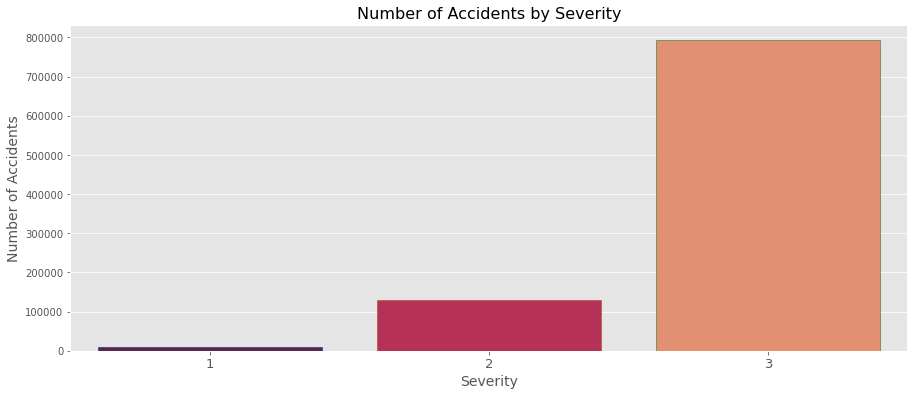

<Figure size 4800x3200 with 0 Axes>

In [33]:
severity = df.groupby(['Accident_Severity'])['Accident_Index'].count().reset_index()


import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
plt.style.use('ggplot')
fig, ax = plt.subplots(1, figsize=(15,6))
x = severity.iloc[:, 0]
y = severity.iloc[:,1]
# ax.bar(x, y, color='b')
sns.barplot(x,y,palette='rocket',edgecolor=sns.color_palette('dark',7))
# sns.lineplot(x,y,color='salmon')
plt.xticks(fontsize=13)
ax.set_xlabel("Severity", fontsize=14)
ax.set_ylabel("Number of Accidents", fontsize=14)
ax.set_title("Number of Accidents by Severity", fontsize=16)
plt.figure(dpi=800);

Text(0.5, 0, '0 - Sunday ,  1 - Monday  ,2 - Tuesday , 3 - Wednesday , 4 - Thursday , 5 - Friday , 6 - Saturday')

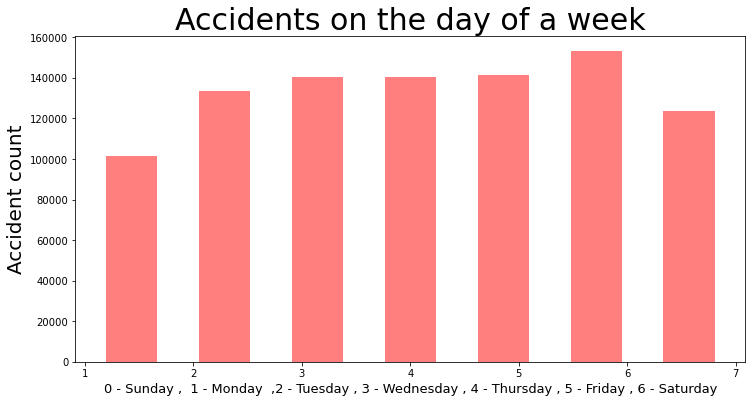

In [27]:
plt.figure(figsize=(12,6))
df.Day_of_Week.hist(bins=7,rwidth=0.55,alpha=0.5, color= 'red')
plt.title('Accidents on the day of a week' , fontsize= 30)
plt.grid(False)
plt.ylabel('Accident count' , fontsize = 20)
plt.xlabel('0 - Sunday ,  1 - Monday  ,2 - Tuesday , 3 - Wednesday , 4 - Thursday , 5 - Friday , 6 - Saturday' , fontsize = 13)

In [29]:
df.groupby(['Speed_limit'])['Accident_Index'].count()

Speed_limit
10         5
15         3
20     14046
30    609693
40     76105
50     33124
60    136343
70     64820
Name: Accident_Index, dtype: int64

/opt/anaconda3/lib/python3.7/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


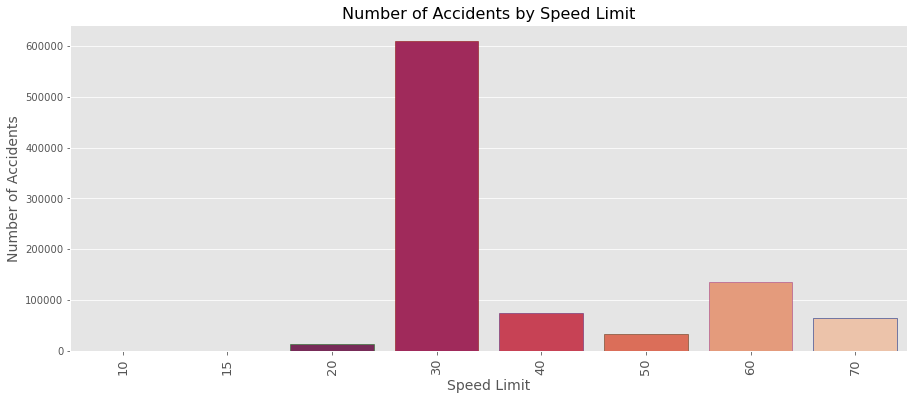

<Figure size 4800x3200 with 0 Axes>

In [30]:
limit = df.groupby(['Speed_limit'])['Accident_Index'].count().reset_index()





import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
plt.style.use('ggplot')
fig, ax = plt.subplots(1, figsize=(15,6))
x = limit.iloc[:, 0]
y = limit.iloc[:,1]
# ax.bar(x, y, color='b')
sns.barplot(x,y,palette='rocket',edgecolor=sns.color_palette('dark',7))
# sns.lineplot(x,y,color='salmon')
plt.xticks(rotation=90, fontsize=13)
ax.set_xlabel("Speed Limit", fontsize=14)
ax.set_ylabel("Number of Accidents", fontsize=14)
ax.set_title("Number of Accidents by Speed Limit", fontsize=16)
plt.figure(dpi=800);


In [183]:


light = df.groupby(['Light_Conditions'])['Accident_Index'].count().reset_index().sort_values('Accident_Index', ascending=False)


light.head(8)

,Light_Conditions,Accident_Index
4,Daylight: Street light present,687940
2,Darkness: Street lights present and lit,181934
0,Darkeness: No street lighting,48359
1,Darkness: Street lighting unknown,11464
3,Darkness: Street lights present but unlit,4442


/opt/anaconda3/lib/python3.7/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


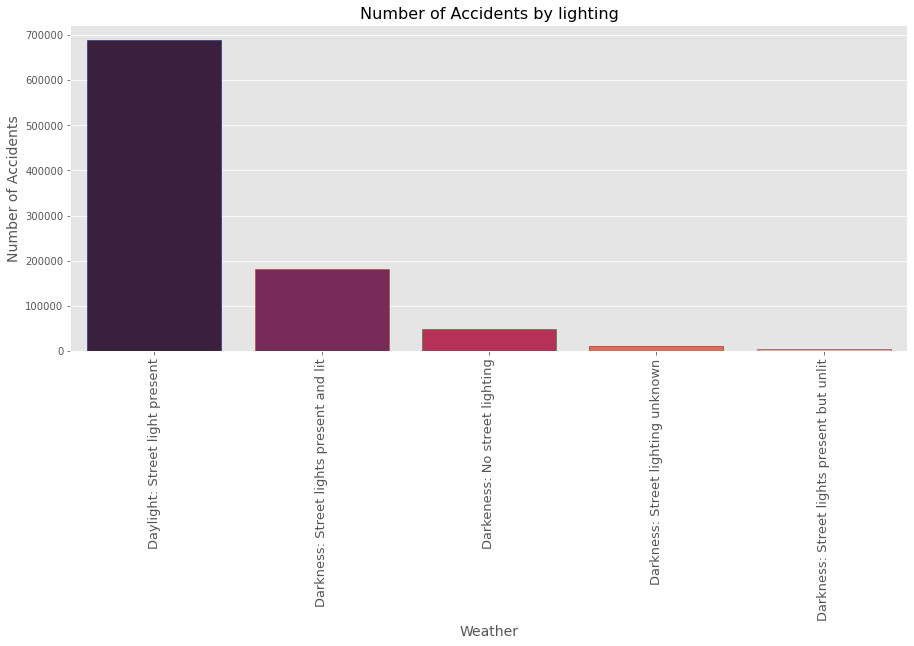

<Figure size 4800x3200 with 0 Axes>

In [179]:
fig, ax = plt.subplots(1, figsize=(15,6))
x = light.iloc[:, 0]
y = light.iloc[:,1]
# ax.bar(x, y, color='b')
sns.barplot(x,y,palette='rocket',edgecolor=sns.color_palette('dark',7))
# sns.lineplot(x,y,color='salmon')
plt.xticks(rotation=90, fontsize=13)
ax.set_xlabel("Weather", fontsize=14)
ax.set_ylabel("Number of Accidents", fontsize=14)
ax.set_title("Number of Accidents by lighting", fontsize=16)
plt.figure(dpi=800);

In [184]:
weather = df.groupby(['Weather_Conditions'])['Accident_Index'].count().reset_index().sort_values('Accident_Index', ascending=False)


weather.head(15)


,Weather_Conditions,Accident_Index
1,Fine without high winds,749869
5,Raining without high winds,109040
3,Other,20084
8,Unknown,16918
4,Raining with high winds,12772
0,Fine with high winds,10810
7,Snowing without high winds,8317
2,Fog or mist,4810
6,Snowing with high winds,1413


/opt/anaconda3/lib/python3.7/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


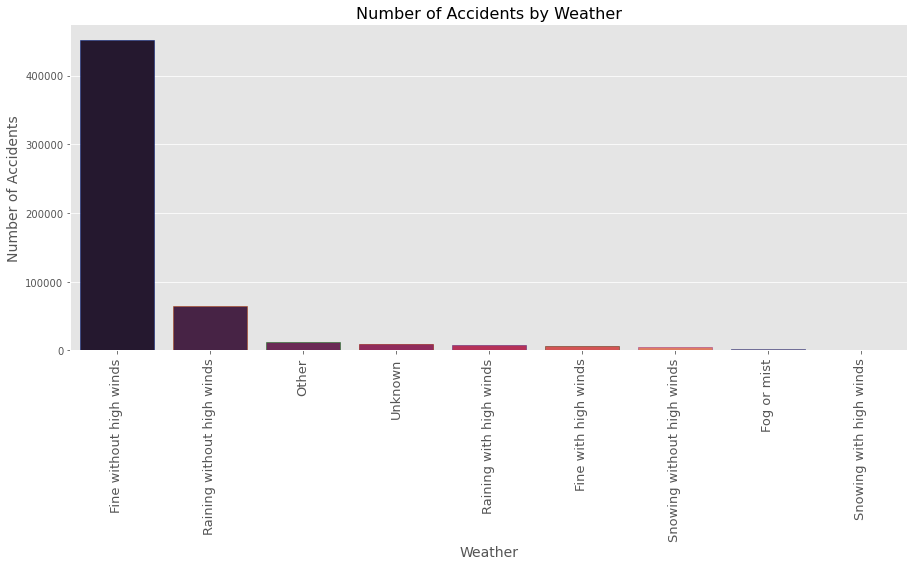

<Figure size 4800x3200 with 0 Axes>

In [59]:


fig, ax = plt.subplots(1, figsize=(15,6))
x = weather.iloc[:, 0]
y = weather.iloc[:,1]
# ax.bar(x, y, color='b')
sns.barplot(x,y,palette='rocket',edgecolor=sns.color_palette('dark',7))
# sns.lineplot(x,y,color='salmon')
plt.xticks(rotation=90, fontsize=13)
ax.set_xlabel("Weather", fontsize=14)
ax.set_ylabel("Number of Accidents", fontsize=14)
ax.set_title("Number of Accidents by Weather", fontsize=16)
plt.figure(dpi=800);


In [157]:
yr = df.groupby(['Year'])['Accident_Index'].count().reset_index()


yr.head(15)


,Year,Accident_Index
0,2009,163554
1,2010,154414
2,2011,151474
3,2012,179715
4,2013,138660
5,2014,146322


/opt/anaconda3/lib/python3.7/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


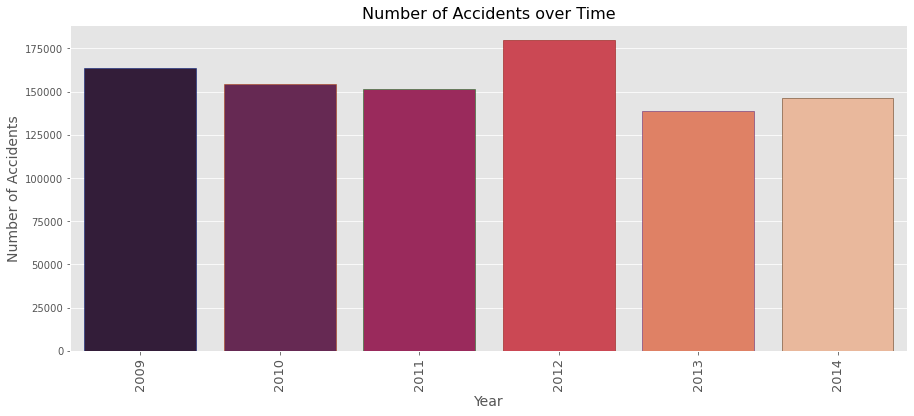

<Figure size 4800x3200 with 0 Axes>

In [158]:
fig, ax = plt.subplots(1, figsize=(15,6))
x = yr.iloc[:, 0]
y = yr.iloc[:,1]
# ax.bar(x, y, color='b')
sns.barplot(x,y,palette='rocket',edgecolor=sns.color_palette('dark',7))
# sns.lineplot(x,y,color='salmon')
plt.xticks(rotation=90, fontsize=13)
ax.set_xlabel("Year", fontsize=14)
ax.set_ylabel("Number of Accidents", fontsize=14)
ax.set_title("Number of Accidents over Time", fontsize=16)
plt.figure(dpi=800);


In [60]:
urb_rur = df.groupby(['Urban_or_Rural_Area'])['Accident_Index'].count().reset_index()
urb_rurThe 


,Urban_or_Rural_Area,Accident_Index
0,1,611246
1,2,322893


<AxesSubplot:>

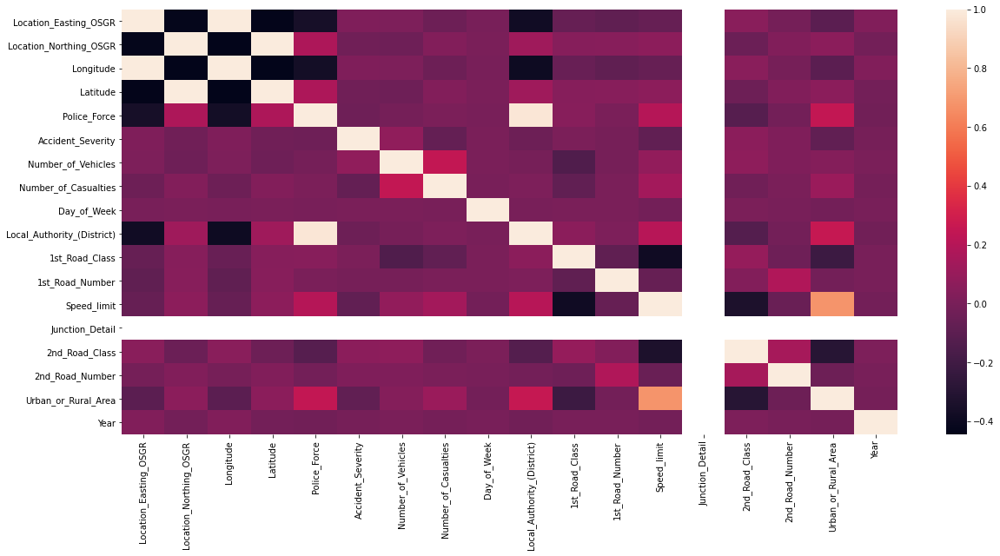

In [28]:
corr =  df.corr()
plt.subplots(figsize=(20,9))
sns.heatmap(corr)

In [35]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression


### Spliting the data into training data and test data

In [40]:
accident_ml = df[['Day_of_Week' , 'Urban_or_Rural_Area', 'Speed_limit']]

# Split the data into a training and test set.
X_train, X_test, y_train, y_test = train_test_split(accident_ml.values, df['Accident_Severity'].values,test_size=0.20, random_state=99)

In [41]:
# lr = LogisticRegression()
# # Fit the model on the trainng data.
# lr.fit(X_train, y_train)
# y_pred = lr.predict(X_test)
# sk_report = classification_report(
#     digits=6,
#     y_true=y_test, 
#     y_pred=y_pred)
# print("Accuracy", round(accuracy_score(y_pred, y_test)*100,2))
# print(sk_report)
# pd.crosstab(y_test, y_pred, rownames=['Actual'], colnames=['Predicted'], margins=True)

/opt/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_logistic.py:764: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG)


NameError: name 'classification_report' is not defined

In [45]:
from sklearn.metrics import accuracy_score

lr = LogisticRegression(random_state=0)
lr.fit(X_train,y_train)
y_pred=lr.predict(X_test)

# Get the accuracy score
acc=accuracy_score(y_test, y_pred)

print(acc)

0.8492035455070974


/opt/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_logistic.py:764: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG)


In [47]:
feature_imp = pd.Series(df.feature_importances_,index=X.columns).sort_values(ascending=False)

# Creating a bar plot, displaying only the top k features
k=10
sns.barplot(x=feature_imp[:10], y=feature_imp.index[:k])
# Add labels to your graph
plt.xlabel('Feature Importance Score')
plt.ylabel('Features')
plt.title("Visualizing Important Features")
plt.legend()
plt.show()

AttributeError: 'DataFrame' object has no attribute 'feature_importances_'

In [61]:
df.info

<bound method DataFrame.info of        Accident_Index  Location_Easting_OSGR  Location_Northing_OSGR  \
0       200901BS70001                 524910                  180800   
1       200901BS70002                 525050                  181040   
2       200901BS70003                 526490                  177990   
3       200901BS70004                 524800                  180300   
4       200901BS70005                 526930                  177490   
...               ...                    ...                     ...   
464692       2.01E+12                 310037                  597647   
464693       2.01E+12                 321509                  574063   
464694       2.01E+12                 321337                  566365   
464695       2.01E+12                 323869                  566853   
464696       2.01E+12                 314072                  579971   

        Longitude   Latitude  Police_Force  Accident_Severity  \
0       -0.201349  51.512273          

<function matplotlib.pyplot.show(close=None, block=None)>

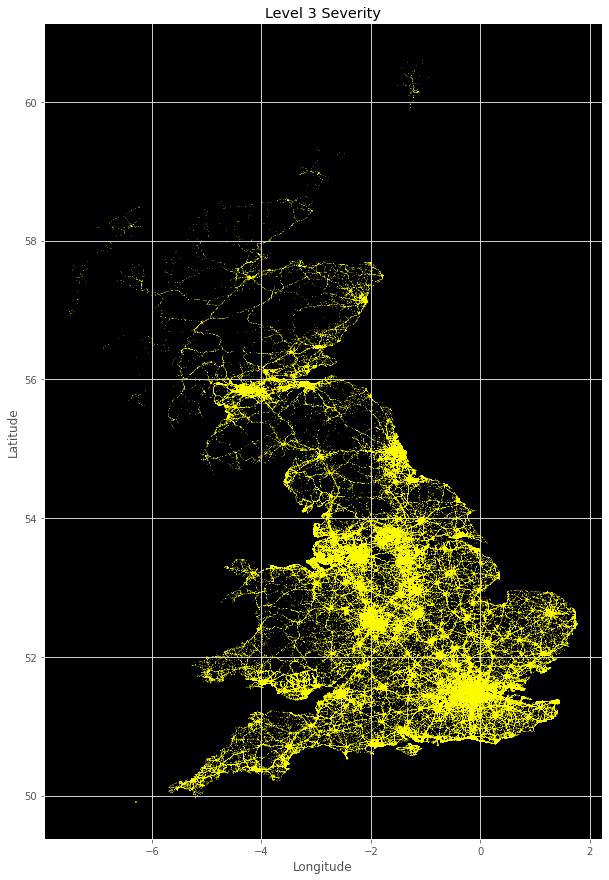

In [77]:
level3 = df[df['Accident_Severity'] == 3]

fig, ax = plt.subplots(1, figsize=(10,15))
level3.plot(kind='scatter', x='Longitude',y ='Latitude',
                color='yellow', 
                s=.09, alpha=.6, subplots=True, ax=ax)
ax.set_title("Level 3 Severity")
ax.set_facecolor('black');

plt.show

<function matplotlib.pyplot.show(close=None, block=None)>

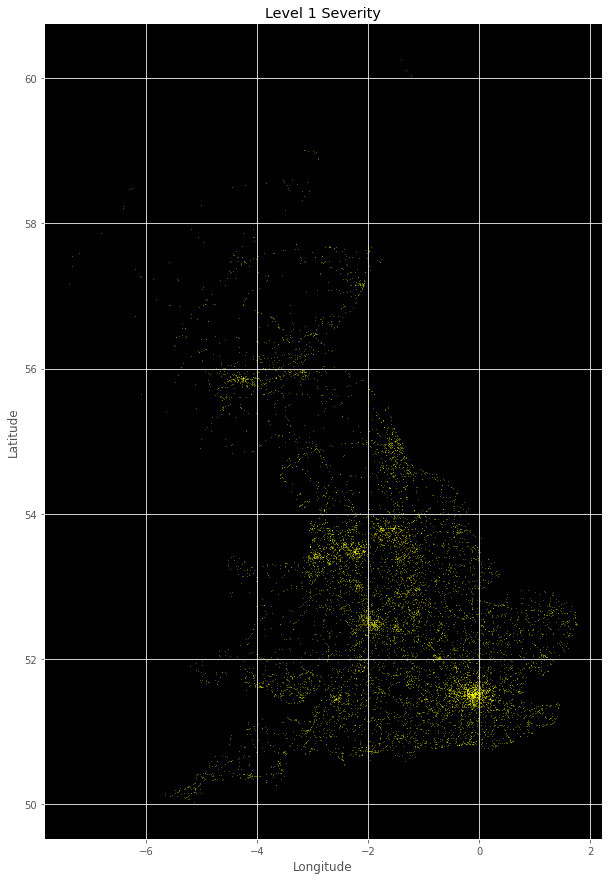

In [94]:
level1 = df[df['Accident_Severity'] == 1]

fig, ax = plt.subplots(1, figsize=(10,15))
level1.plot(kind='scatter', x='Longitude',y ='Latitude',
                color='yellow', 
                s=.1, alpha=.6, subplots=True, ax=ax)
ax.set_title("Level 1 Severity")
ax.set_facecolor('black');

plt.show

In [136]:
accident_df = df.copy()

In [137]:
# accident_df["Accident_Severity"]= accident_df["Accident_Severity"].map({1:0, 2:0})

accident_df["Accident_Severity"].replace({2:1, 3:0}, inplace=True)


In [138]:
accident_df["Accident_Severity"].head()

0    1
1    1
2    0
3    1
4    1
Name: Accident_Severity, dtype: int64

In [155]:
accident_df.head(15)

,Accident_Index,Location_Easting_OSGR,Location_Northing_OSGR,Longitude,Latitude,Police_Force,Accident_Severity,Number_of_Vehicles,Number_of_Casualties,Date,...,Pedestrian_Crossing-Physical_Facilities,Light_Conditions,Weather_Conditions,Road_Surface_Conditions,Special_Conditions_at_Site,Carriageway_Hazards,Urban_or_Rural_Area,Did_Police_Officer_Attend_Scene_of_Accident,LSOA_of_Accident_Location,Year
0,200901BS70001,524910,180800,-0.201349,51.512273,1,1,2,1,01/01/2009,...,No physical crossing within 50 meters,Daylight: Street light present,Fine without high winds,Dry,None,None,1,Yes,E01002882,2009
1,200901BS70002,525050,181040,-0.199248,51.514399,1,1,2,11,05/01/2009,...,Zebra crossing,Daylight: Street light present,Fine without high winds,Wet/Damp,None,None,1,Yes,E01002886,2009
2,200901BS70003,526490,177990,-0.179599,51.486668,1,0,2,1,04/01/2009,...,No physical crossing within 50 meters,Daylight: Street light present,Fine without high winds,Dry,None,None,1,Yes,E01002912,2009
3,200901BS70004,524800,180300,-0.203110,51.507804,1,1,2,1,05/01/2009,...,Pedestrian phase at traffic signal junction,Daylight: Street light present,Other,Frost/Ice,None,None,1,Yes,E01002871,2009
4,200901BS70005,526930,177490,-0.173445,51.482076,1,1,2,1,06/01/2009,...,No physical crossing within 50 meters,Darkness: Street lights present and lit,Fine without high winds,Dry,None,None,1,Yes,E01002840,2009
5,200901BS70006,526060,178730,-0.185525,51.493415,1,0,2,3,01/01/2009,...,No physical crossing within 50 meters,Daylight: Street light present,Fine without high winds,Dry,None,None,1,Yes,E01002839,2009
6,200901BS70007,526580,177270,-0.178561,51.480177,1,1,2,1,08/01/2009,...,No physical crossing within 50 meters,Daylight: Street light present,Fine without high winds,Dry,None,None,1,Yes,E01002841,2009
7,200901BS70008,526550,178580,-0.178524,51.491957,1,0,1,1,02/01/2009,...,Pedestrian phase at traffic signal junction,Daylight: Street light present,Fine without high winds,Dry,None,None,1,Yes,E01002835,2009
8,200901BS70009,527310,179100,-0.167395,51.496460,1,0,1,2,07/01/2009,...,No physical crossing within 50 meters,Daylight: Street light present,Fine without high winds,Dry,None,None,1,Yes,E01002819,2009
9,200901BS70010,526250,177370,-0.183275,51.481150,1,0,1,1,10/01/2009,...,No physical crossing within 50 meters,Daylight: Street light present,Other,Wet/Damp,Roadworks,None,1,Yes,E01002843,2009


/opt/anaconda3/lib/python3.7/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


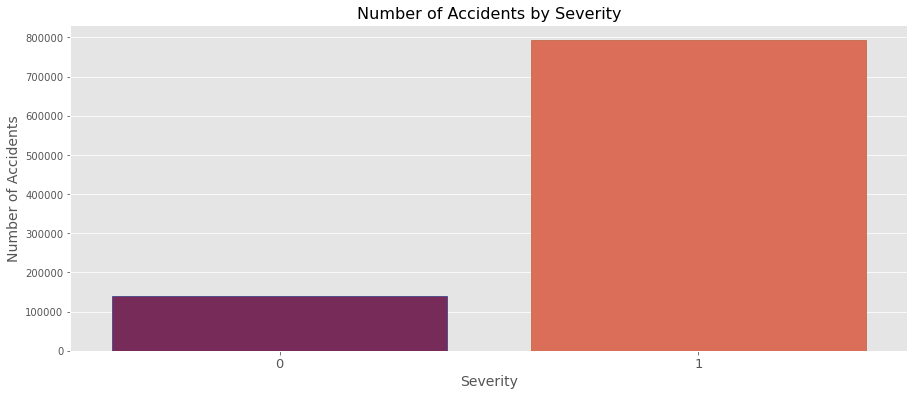

<Figure size 4800x3200 with 0 Axes>

In [104]:
severity_ = accident_df.groupby(['Accident_Severity'])['Accident_Index'].count().reset_index()

import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
plt.style.use('ggplot')
fig, ax = plt.subplots(1, figsize=(15,6))
x = severity_.iloc[:, 0]
y = severity_.iloc[:,1]
# ax.bar(x, y, color='b')
sns.barplot(x,y,palette='rocket',edgecolor=sns.color_palette('dark',7))
# sns.lineplot(x,y,color='salmon')
plt.xticks(fontsize=13)
ax.set_xlabel("Severity", fontsize=14)
ax.set_ylabel("Number of Accidents", fontsize=14)
ax.set_title("Number of Accidents by Severity", fontsize=16)
plt.figure(dpi=800);

In [162]:
#  Creating a new column for the hour of the day

accident_df['Hour_of_Day'] = accident_df['Time'].str[:2]



In [163]:
time_viewing = accident_df[['Hour_of_Day','Time']]

time_viewing.head()

,Hour_of_Day,Time
0,15,15:11
1,10,10:59
2,14,14:19
3,08,08:10
4,17,17:25


In [165]:
tm = accident_df.groupby(['Hour_of_Day'])['Accident_Index'].count().reset_index()


tm.head(24)


,Hour_of_Day,Accident_Index
0,00,13512
1,01,9969
2,02,7788
3,03,6654
4,04,5279
5,05,7776
6,06,16790
7,07,39738
8,08,68873
9,09,47202


/opt/anaconda3/lib/python3.7/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


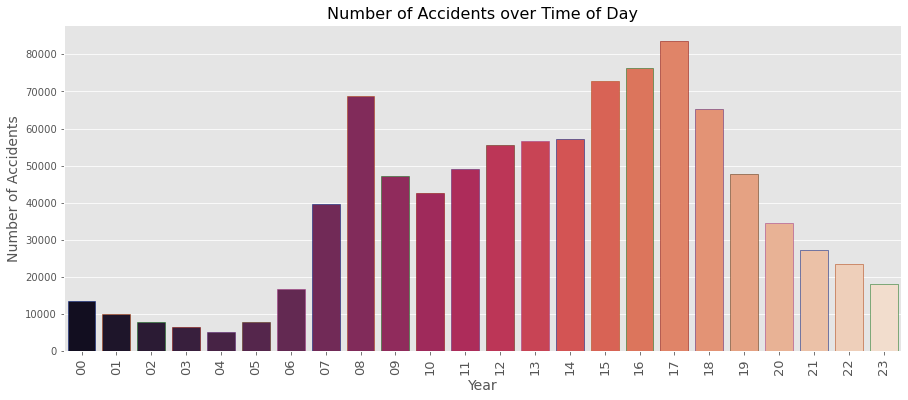

<Figure size 4800x3200 with 0 Axes>

In [166]:
fig, ax = plt.subplots(1, figsize=(15,6))
x = tm.iloc[:, 0]
y = tm.iloc[:,1]
# ax.bar(x, y, color='b')
sns.barplot(x,y,palette='rocket',edgecolor=sns.color_palette('dark',7))
# sns.lineplot(x,y,color='salmon')
plt.xticks(rotation=90, fontsize=13)
ax.set_xlabel("Year", fontsize=14)
ax.set_ylabel("Number of Accidents", fontsize=14)
ax.set_title("Number of Accidents over Time of Day", fontsize=16)
plt.figure(dpi=800);


<function matplotlib.pyplot.show(close=None, block=None)>

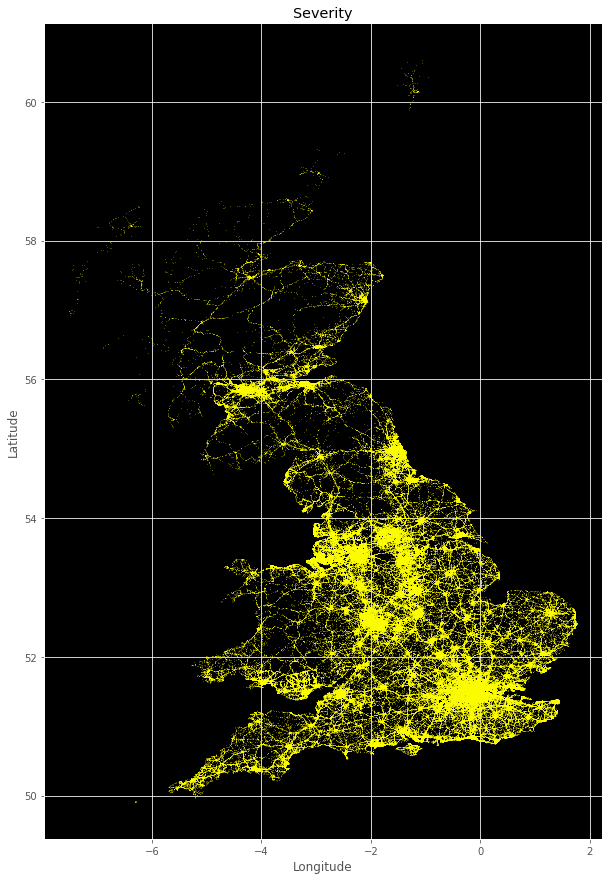

In [256]:
level12 = accident_df[accident_df['Accident_Severity'] == 0]

fig, ax = plt.subplots(1, figsize=(10,15))
level12.plot(kind='scatter', x='Longitude',y ='Latitude',
                color='yellow', 
                s=.1, alpha=.5, subplots=True, ax=ax)
ax.set_title("Severity")
ax.set_facecolor('black');

plt.show

<function matplotlib.pyplot.show(close=None, block=None)>

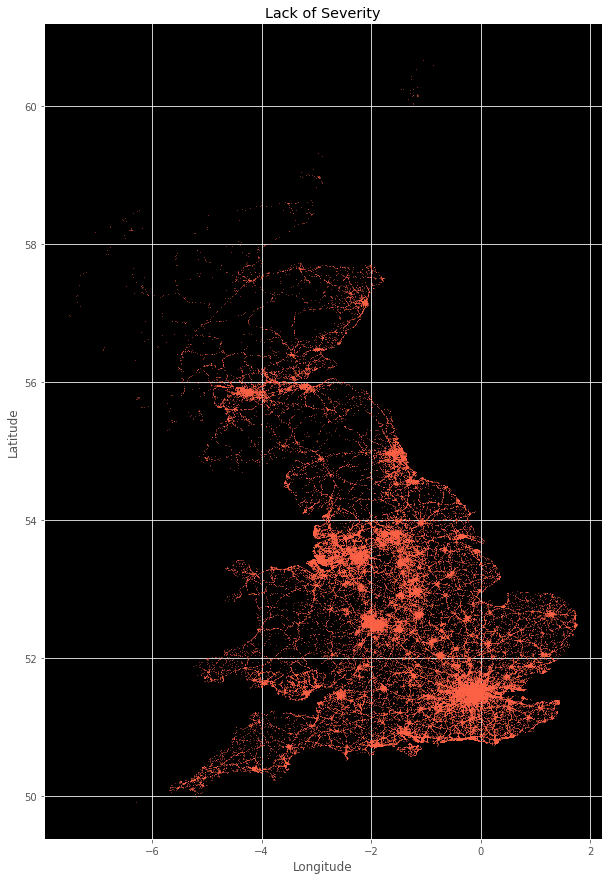

In [294]:
level3_ = accident_df[accident_df['Accident_Severity'] == 1]

fig, ax = plt.subplots(1, figsize=(10,15))
level3_.plot(kind='scatter', x='Longitude',y ='Latitude',
                color='tomato', 
                s=.1, alpha=.8, subplots=True, ax=ax)
ax.set_title("Lack of Severity")
ax.set_facecolor('black');

plt.show

<Figure size 1008x576 with 0 Axes>

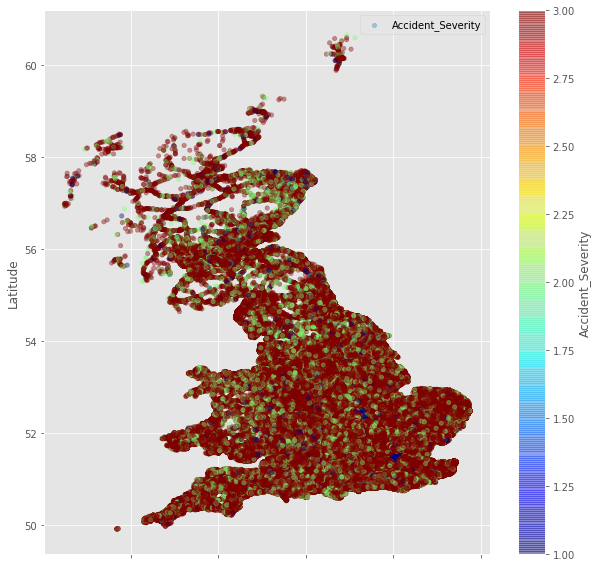

In [118]:
plt.figure(figsize=(14,8))

viz_4=df.plot(kind='scatter', x='Longitude',y='Latitude',label='Accident_Severity',c='Accident_Severity',cmap=plt.get_cmap('jet'),colorbar=True,alpha=0.4,figsize=(10,10))
viz_4.legend()
plt.show()

In [125]:
data_heat = df[['Latitude','Longitude','Accident_Severity']].values.tolist()
import folium
import folium.plugins as plugins
location = df['Latitude'].mean(), df['Longitude'].mean()

m = folium.Map(location=location, zoom_start=15)
#tiles='stamentoner'

plugins.HeatMap(data_heat).add_to(m)

m


In [282]:
new = df.sample(frac =.000009)

data_heat_ = new[['Latitude','Longitude',]].values.tolist()
import folium
import folium.plugins as plugins
location = new['Latitude'].mean(), new['Longitude'].mean()

m = folium.Map(location=location, zoom_start=15)
#tiles='stamentoner'

plugins.HeatMap(data_heat_).add_to(m)

m


In [130]:
locations = df.groupby(['Police_Force'])['Accident_Index'].count().reset_index().sort_values('Accident_Index', ascending=False)

locations.head(10)

,Police_Force,Accident_Index
0,1,153603
13,20,34430
9,13,34369
4,6,33702
28,43,33242
31,46,29791
2,4,28727
29,44,28235
34,50,24959
32,47,24689


In [ ]:
# Greater London - 16% of all accidents -  153,603 / 934,139
# West Midlands - contains Birmingham, second largest city in the UK
# West Yorkshire - contains Leeds - 4th largest urban area in UK
# Greater Manchester
# Thames Valley

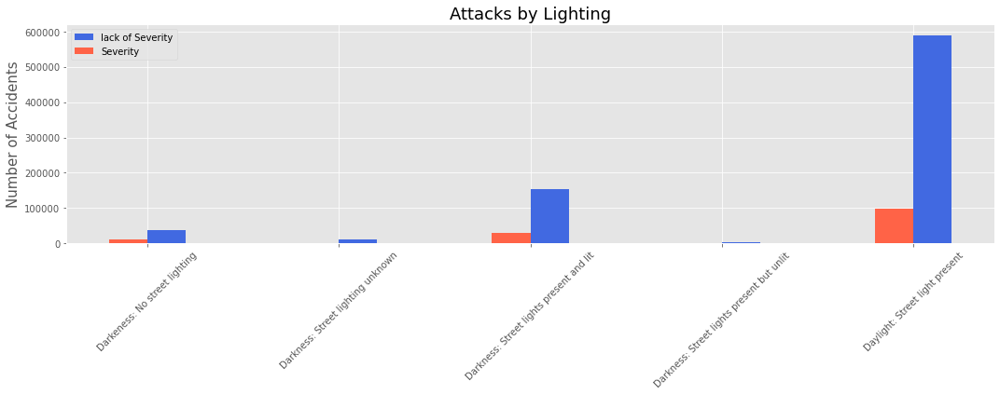

In [173]:
sev_0 = accident_df[(accident_df['Accident_Severity'] == 0)]

sev_1 = accident_df[(accident_df['Accident_Severity'] == 1)]


type_0 = sev_0.groupby('Light_Conditions')['Accident_Index'].count().to_frame().reset_index()

type_1 = sev_1.groupby('Light_Conditions')['Accident_Index'].count().to_frame().reset_index()


fig, ax = plt.subplots(1, figsize=(15, 6))
bar_width = 0.2
x1 = type_0.iloc[:, 0]
x2 = type_1.iloc[:,0]
y1 = type_0.iloc[:,1]
y2 = type_1.iloc[:,1]
ax.bar(x1, y1, color='royalblue', width=bar_width, align='edge', label='lack of Severity')
ax.bar(x2, y2, color='tomato', width=-bar_width, align='edge', label='Severity')
plt.xticks(rotation=45, fontsize=10, horizontalalignment='center')
ax.set_ylabel("Number of Accidents", fontsize=15)
ax.set_title("Attacks by Lighting", fontsize=18)
fig.tight_layout()
ax.legend()


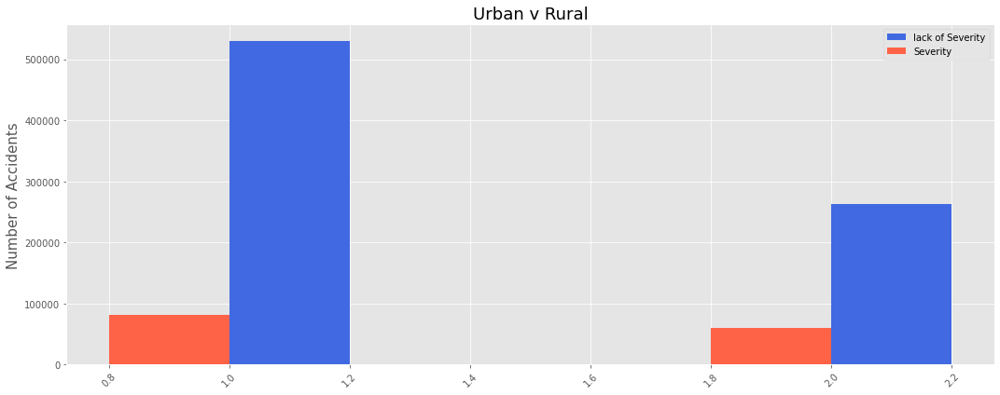

In [174]:
urb_0 = sev_0.groupby('Urban_or_Rural_Area')['Accident_Index'].count().to_frame().reset_index()

urb_1 = sev_1.groupby('Urban_or_Rural_Area')['Accident_Index'].count().to_frame().reset_index()


fig, ax = plt.subplots(1, figsize=(15, 6))
bar_width = 0.2
x1 = urb_0.iloc[:, 0]
x2 = urb_1.iloc[:,0]
y1 = urb_0.iloc[:,1]
y2 = urb_1.iloc[:,1]
ax.bar(x1, y1, color='royalblue', width=bar_width, align='edge', label='lack of Severity')
ax.bar(x2, y2, color='tomato', width=-bar_width, align='edge', label='Severity')
plt.xticks(rotation=45, fontsize=10, horizontalalignment='center')
ax.set_ylabel("Number of Accidents", fontsize=15)
ax.set_title("Urban v Rural", fontsize=18)
fig.tight_layout()
ax.legend()

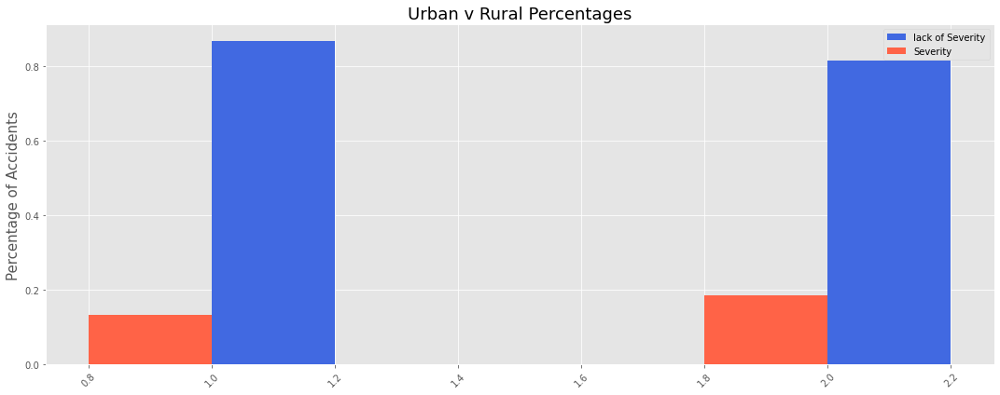

In [293]:
urb_0 = sev_0.groupby('Urban_or_Rural_Area')['Accident_Index'].count().to_frame().reset_index()

urb_1 = sev_1.groupby('Urban_or_Rural_Area')['Accident_Index'].count().to_frame().reset_index()


fig, ax = plt.subplots(1, figsize=(15, 6))
bar_width = 0.2
x1 = urb_0.iloc[:,0]
x2 = urb_1.iloc[:,0]
y1 = urb_0.iloc[:,1]
y2 = urb_1.iloc[:,1]
ax.bar(x1, (y1/(y1+y2)), color='royalblue', width=bar_width, align='edge', label='lack of Severity')
ax.bar(x2, (y2/(y1+y2)), color='tomato', width=-bar_width, align='edge', label='Severity')
plt.xticks(rotation=45, fontsize=10, horizontalalignment='center')
ax.set_ylabel("Percentage of Accidents", fontsize=15)
ax.set_title("Urban v Rural Percentages", fontsize=18)
fig.tight_layout()
ax.legend()

In [175]:
no_sev_locations = sev_0.groupby(['Police_Force'])['Accident_Index'].count().reset_index().sort_values('Accident_Index', ascending=False)

no_sev_locations.head(5)

,Police_Force,Accident_Index
0,1,136135
13,20,29182
9,13,29099
4,6,28954
28,43,28094


In [176]:
no_sev_locations = sev_1.groupby(['Police_Force'])['Accident_Index'].count().reset_index().sort_values('Accident_Index', ascending=False)

no_sev_locations.head(5)

,Police_Force,Accident_Index
0,1,17468
29,44,5729
9,13,5270
13,20,5248
28,43,5148


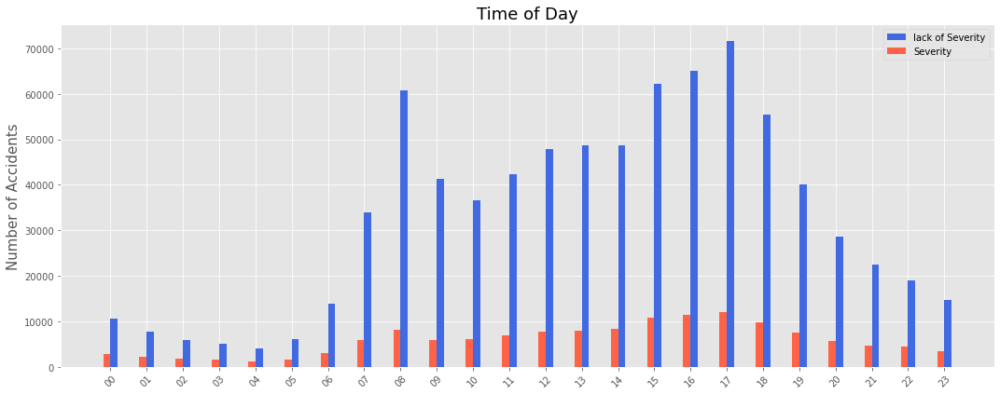

In [177]:
tm_0 = sev_0.groupby(['Hour_of_Day'])['Accident_Index'].count().reset_index()

tm_1 = sev_1.groupby(['Hour_of_Day'])['Accident_Index'].count().reset_index()

fig, ax = plt.subplots(1, figsize=(15, 6))
bar_width = 0.2
x1 = tm_0.iloc[:, 0]
x2 = tm_1.iloc[:,0]
y1 = tm_0.iloc[:,1]
y2 = tm_1.iloc[:,1]
ax.bar(x1, y1, color='royalblue', width=bar_width, align='edge', label='lack of Severity')
ax.bar(x2, y2, color='tomato', width=-bar_width, align='edge', label='Severity')
plt.xticks(rotation=45, fontsize=10, horizontalalignment='center')
ax.set_ylabel("Number of Accidents", fontsize=15)
ax.set_title("Time of Day", fontsize=18)
fig.tight_layout()
ax.legend()



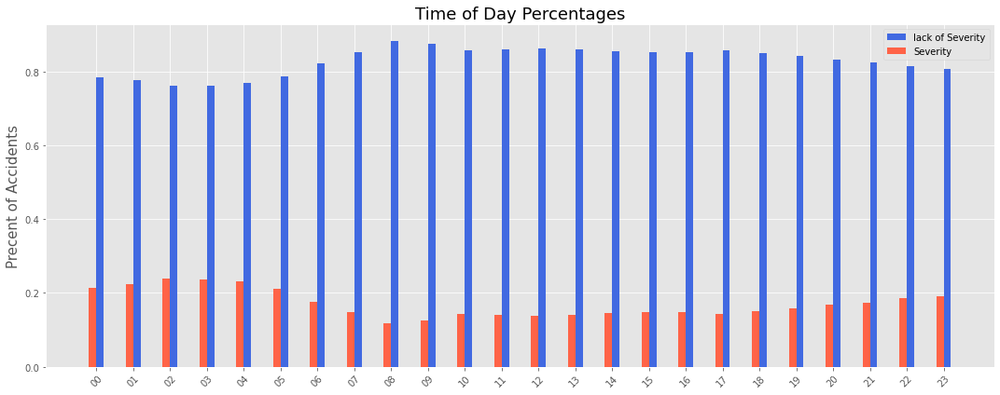

In [276]:
tm_0 = sev_0.groupby(['Hour_of_Day'])['Accident_Index'].count().reset_index()

tm_1 = sev_1.groupby(['Hour_of_Day'])['Accident_Index'].count().reset_index()

fig, ax = plt.subplots(1, figsize=(15, 6))
bar_width = 0.2
x1 = tm_0.iloc[:, 0]
x2 = tm_1.iloc[:,0]
y1 = tm_0.iloc[:,1]
y2 = tm_1.iloc[:,1]
ax.bar(x1, (y1/(y1+y2)), color='royalblue', width=bar_width, align='edge', label='lack of Severity')
ax.bar(x2, (y2/(y1+y2)), color='tomato', width=-bar_width, align='edge', label='Severity')
plt.xticks(rotation=45, fontsize=10, horizontalalignment='center')
ax.set_ylabel("Precent of Accidents", fontsize=15)
ax.set_title("Time of Day Percentages", fontsize=18)
fig.tight_layout()
ax.legend()


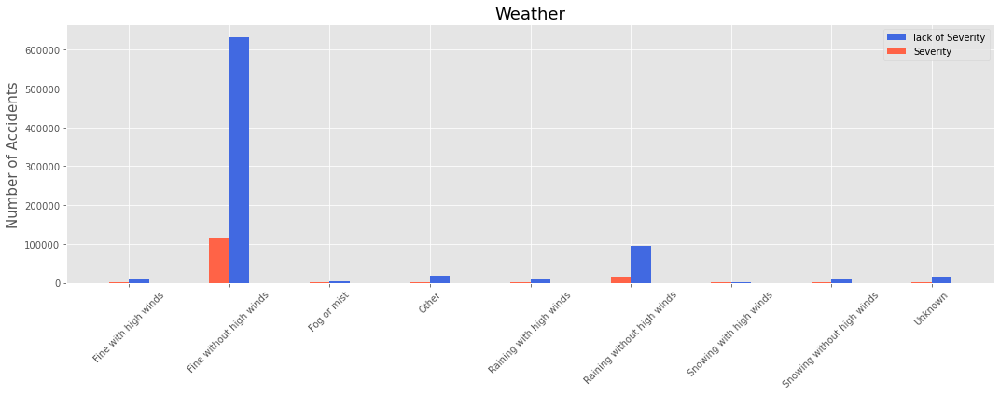

In [185]:
weather_0 = sev_0.groupby(['Weather_Conditions'])['Accident_Index'].count().reset_index()

weather_1 = sev_1.groupby(['Weather_Conditions'])['Accident_Index'].count().reset_index()

fig, ax = plt.subplots(1, figsize=(15, 6))
bar_width = 0.2
x1 = weather_0.iloc[:, 0]
x2 = weather_1.iloc[:,0]
y1 = weather_0.iloc[:,1]
y2 = weather_1.iloc[:,1]
ax.bar(x1, y1, color='royalblue', width=bar_width, align='edge', label='lack of Severity')
ax.bar(x2, y2, color='tomato', width=-bar_width, align='edge', label='Severity')
plt.xticks(rotation=45, fontsize=10, horizontalalignment='center')
ax.set_ylabel("Number of Accidents", fontsize=15)
ax.set_title("Weather", fontsize=18)
fig.tight_layout()
ax.legend()


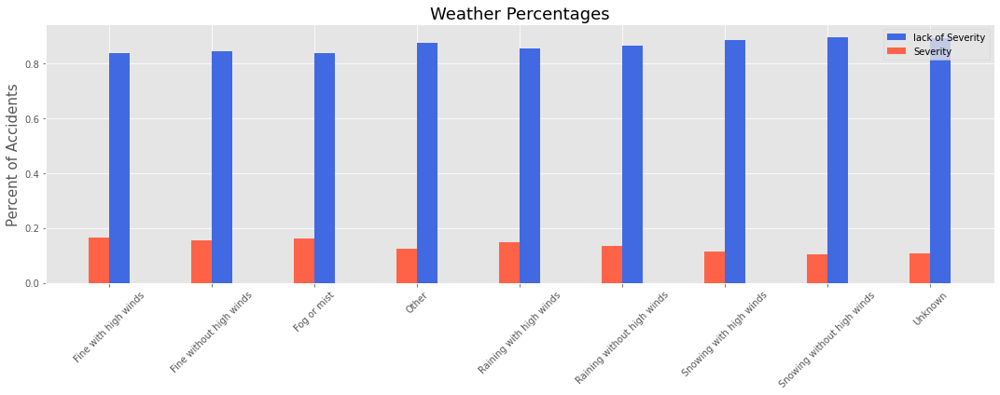

In [291]:
weather_0 = sev_0.groupby(['Weather_Conditions'])['Accident_Index'].count().reset_index()

weather_1 = sev_1.groupby(['Weather_Conditions'])['Accident_Index'].count().reset_index()

fig, ax = plt.subplots(1, figsize=(15, 6))
bar_width = 0.2
x1 = weather_0.iloc[:, 0]
x2 = weather_1.iloc[:,0]
y1 = weather_0.iloc[:,1]
y2 = weather_1.iloc[:,1]
ax.bar(x1, (y1/(y1+y2)), color='royalblue', width=bar_width, align='edge', label='lack of Severity')
ax.bar(x2, (y2/(y1+y2)), color='tomato', width=-bar_width, align='edge', label='Severity')
plt.xticks(rotation=45, fontsize=10, horizontalalignment='center')
ax.set_ylabel("Percent of Accidents", fontsize=15)
ax.set_title("Weather Percentages", fontsize=18)
fig.tight_layout()
ax.legend()


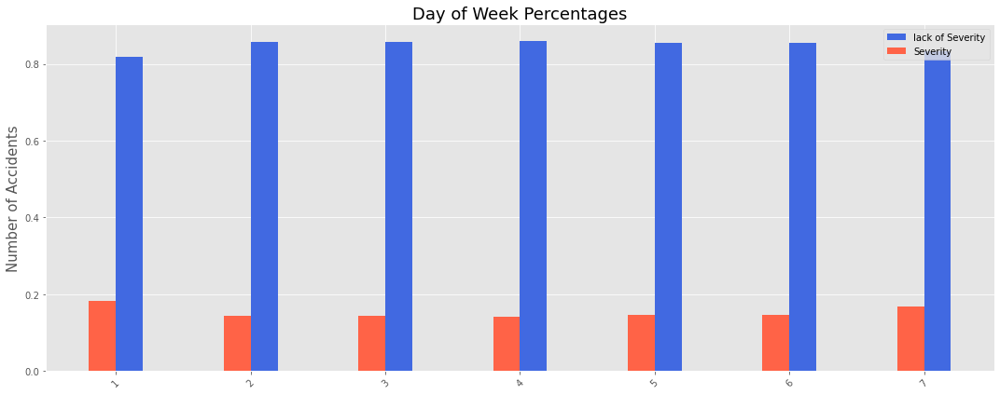

In [279]:
day_0 = sev_0.groupby(['Day_of_Week'])['Accident_Index'].count().reset_index()

day_1 = sev_1.groupby(['Day_of_Week'])['Accident_Index'].count().reset_index()

fig, ax = plt.subplots(1, figsize=(15, 6))
bar_width = 0.2
x1 = day_0.iloc[:, 0]
x2 = day_1.iloc[:,0]
y1 = day_0.iloc[:,1]
y2 = day_1.iloc[:,1]
ax.bar(x1, (y1/(y1+y2)), color='royalblue', width=bar_width, align='edge', label='lack of Severity')
ax.bar(x2, (y2/(y1+y2)), color='tomato', width=-bar_width, align='edge', label='Severity')
plt.xticks(rotation=45, fontsize=10, horizontalalignment='center')
ax.set_ylabel("Number of Accidents", fontsize=15)
ax.set_title("Day of Week Percentages", fontsize=18)
fig.tight_layout()
ax.legend()

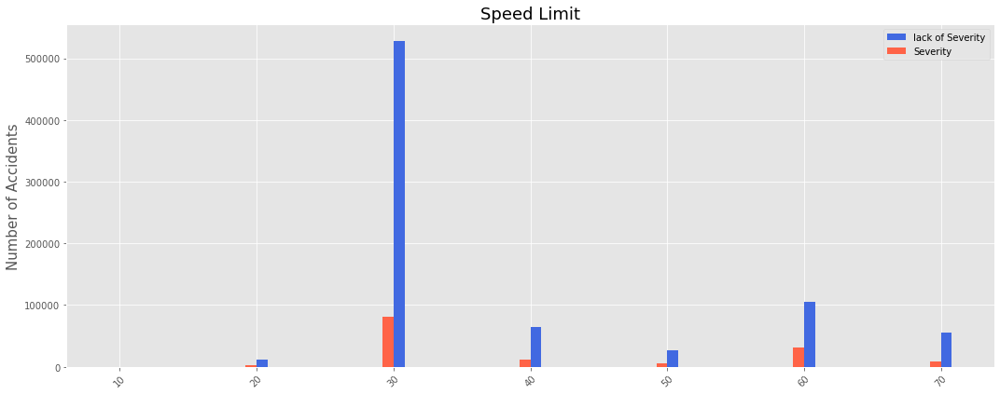

In [273]:
limit_0 = sev_0.groupby(['Speed_limit'])['Accident_Index'].count().reset_index()

limit_1 = sev_1.groupby(['Speed_limit'])['Accident_Index'].count().reset_index()

fig, ax = plt.subplots(1, figsize=(15, 6))
bar_width = 0.8
x1 = limit_0.iloc[:, 0]
x2 = limit_1.iloc[:,0]
y1 = limit_0.iloc[:,1]
y2 = limit_1.iloc[:,1]
ax.bar(x1, y1, color='royalblue', width=bar_width, align='edge', label='lack of Severity')
ax.bar(x2, y2, color='tomato', width=-bar_width, align='edge', label='Severity')
plt.xticks(rotation=45, fontsize=10, horizontalalignment='center')
ax.set_ylabel("Number of Accidents", fontsize=15)
ax.set_title("Speed Limit", fontsize=18)
fig.tight_layout()
ax.legend()

In [269]:
sev_0.shape

(793044, 34)

In [270]:
sev_1.shape

(141095, 34)

In [271]:
print(141095+793044 )

934139


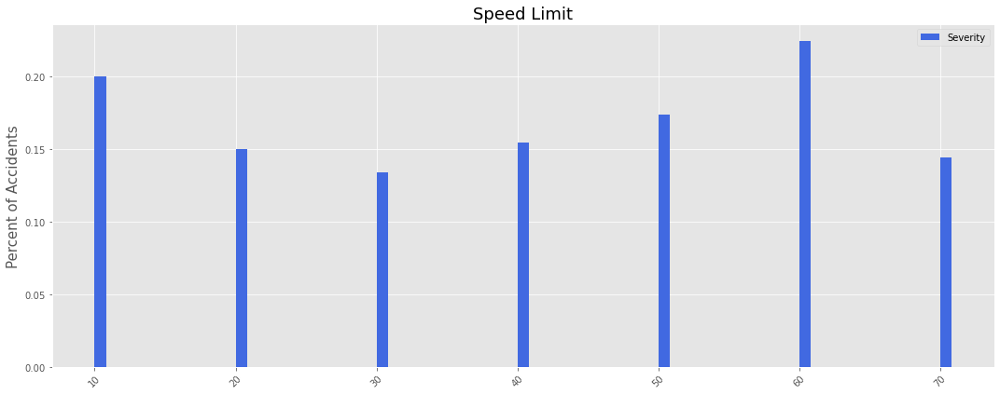

In [274]:
limit_0 = sev_0.groupby(['Speed_limit'])['Accident_Index'].count().reset_index()
# .drop(1).reset_index()

limit_1 = sev_1.groupby(['Speed_limit'])['Accident_Index'].count().reset_index()
new_row = {'Speed_limit':15, 'Accident_Index': 0}
limit_1 = limit_1.append(new_row, ignore_index=True)
limit_1 = limit_1.sort_values('Speed_limit').reset_index().drop('index', axis = 1)

fig, ax = plt.subplots(1, figsize=(15, 6))
bar_width = 0.8
x1 = limit_0.iloc[:, 0]
#x2 = limit_1.iloc[:,0]
y1 = limit_0.iloc[:,1]
y2 = limit_1.iloc[:,1]
ax.bar(x1, (y2/(y2+y1)), color='royalblue', width=bar_width, align='edge', label='Severity')
# ax.bar(x2, y2, color='tomato', width=-bar_width, align='edge', label='Severity')
plt.xticks(rotation=45, fontsize=10, horizontalalignment='center')
ax.set_ylabel("Percent of Accidents", fontsize=15)
ax.set_title("Speed Limit", fontsize=18)
fig.tight_layout()
ax.legend()

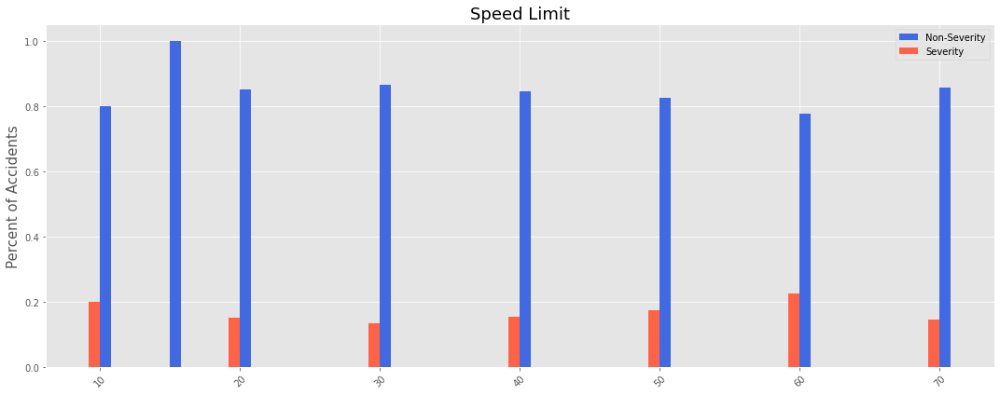

In [265]:
fig, ax = plt.subplots(1, figsize=(15, 6))
bar_width = 0.8
x1 = limit_0.iloc[:, 0]
x2 = limit_1.iloc[:,0]
y1 = limit_0.iloc[:,1]
y2 = limit_1.iloc[:,1]
ax.bar(x1, (y1/(y2+y1)), color='royalblue', width=bar_width, align='edge', label='Non-Severity')
ax.bar(x2, (y2/(y2+y1)), color='tomato', width=-bar_width, align='edge', label='Severity')
plt.xticks(rotation=45, fontsize=10, horizontalalignment='center')
ax.set_ylabel("Percent of Accidents", fontsize=15)
ax.set_title("Speed Limit", fontsize=18)
fig.tight_layout()
ax.legend()

In [ ]:
# Here we can see that at 60 KM, severve accidents is at its highest percentage. 

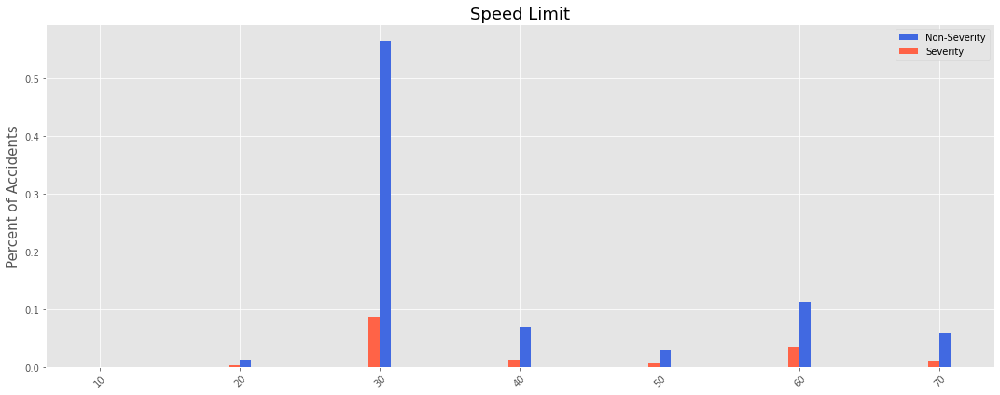

In [272]:
fig, ax = plt.subplots(1, figsize=(15, 6))
bar_width = 0.8
x1 = limit_0.iloc[:, 0]
x2 = limit_1.iloc[:,0]
y1 = limit_0.iloc[:,1]
y2 = limit_1.iloc[:,1]
ax.bar(x1, (y1/(934139)), color='royalblue', width=bar_width, align='edge', label='Non-Severity')
ax.bar(x2, (y2/(934139)), color='tomato', width=-bar_width, align='edge', label='Severity')
plt.xticks(rotation=45, fontsize=10, horizontalalignment='center')
ax.set_ylabel("Percent of Accidents", fontsize=15)
ax.set_title("Speed Limit", fontsize=18)
fig.tight_layout()
ax.legend()

In [249]:
limit_0, limit_1

(   Speed_limit  Accident_Index
 0           10               4
 1           15               3
 2           20           11937
 3           30          528116
 4           40           64374
 5           50           27380
 6           60          105738
 7           70           55492,
    Speed_limit  Accident_Index
 0           10               1
 1           15               0
 2           20            2109
 3           30           81577
 4           40           11731
 5           50            5744
 6           60           30605
 7           70            9328)

In [227]:
type(limit_0)

pandas.core.frame.DataFrame

In [219]:
print(y1, y2)

0         4
1         3
2     11937
3    528116
4     64374
5     27380
6    105738
7     55492
Name: Accident_Index, dtype: int64 0        1
1     2109
2    81577
3    11731
4     5744
5    30605
6     9328
Name: Accident_Index, dtype: int64


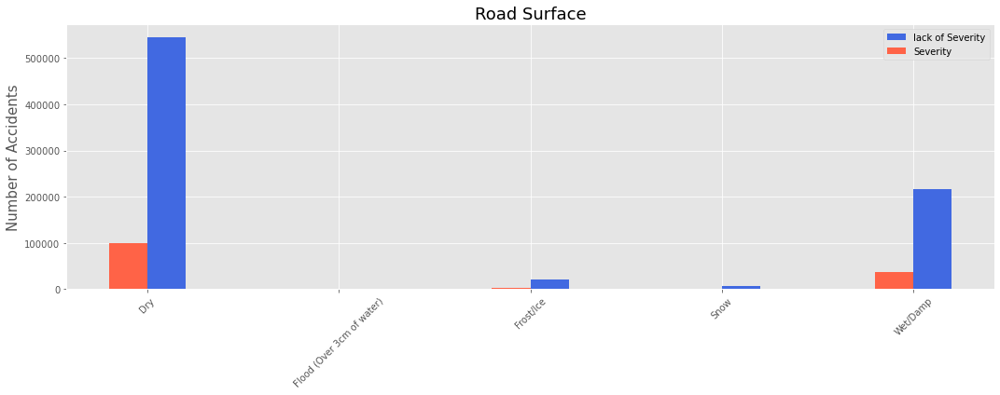

In [212]:
road_conditions_0 = sev_0.groupby(['Road_Surface_Conditions'])['Accident_Index'].count().reset_index()

road_conditions_1 = sev_1.groupby(['Road_Surface_Conditions'])['Accident_Index'].count().reset_index()

fig, ax = plt.subplots(1, figsize=(15, 6))
bar_width = 0.2
x1 = road_conditions_0.iloc[:, 0]
x2 = road_conditions_1.iloc[:,0]
y1 = road_conditions_0.iloc[:,1]
y2 = road_conditions_1.iloc[:,1]
ax.bar(x1, y1, color='royalblue', width=bar_width, align='edge', label='lack of Severity')
ax.bar(x2, y2, color='tomato', width=-bar_width, align='edge', label='Severity')
plt.xticks(rotation=45, fontsize=10, horizontalalignment='center')
ax.set_ylabel("Number of Accidents", fontsize=15)
ax.set_title("Road Surface", fontsize=18)
fig.tight_layout()
ax.legend()

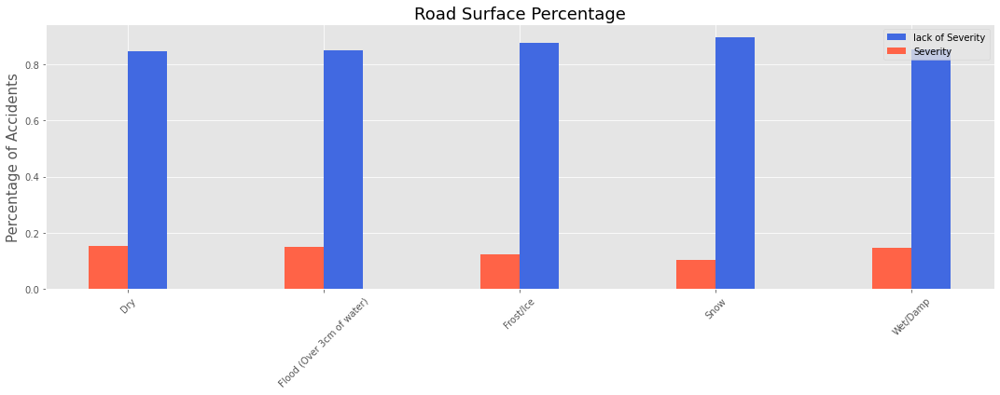

In [292]:
road_conditions_0 = sev_0.groupby(['Road_Surface_Conditions'])['Accident_Index'].count().reset_index()

road_conditions_1 = sev_1.groupby(['Road_Surface_Conditions'])['Accident_Index'].count().reset_index()

fig, ax = plt.subplots(1, figsize=(15, 6))
bar_width = 0.2
x1 = road_conditions_0.iloc[:, 0]
x2 = road_conditions_1.iloc[:,0]
y1 = road_conditions_0.iloc[:,1]
y2 = road_conditions_1.iloc[:,1]
ax.bar(x1, (y1/(y2+y1)), color='royalblue', width=bar_width, align='edge', label='lack of Severity')
ax.bar(x2, (y2/(y2+y1)), color='tomato', width=-bar_width, align='edge', label='Severity')
plt.xticks(rotation=45, fontsize=10, horizontalalignment='center')
ax.set_ylabel("Percentage of Accidents", fontsize=15)
ax.set_title("Road Surface Percentage", fontsize=18)
fig.tight_layout()
ax.legend()

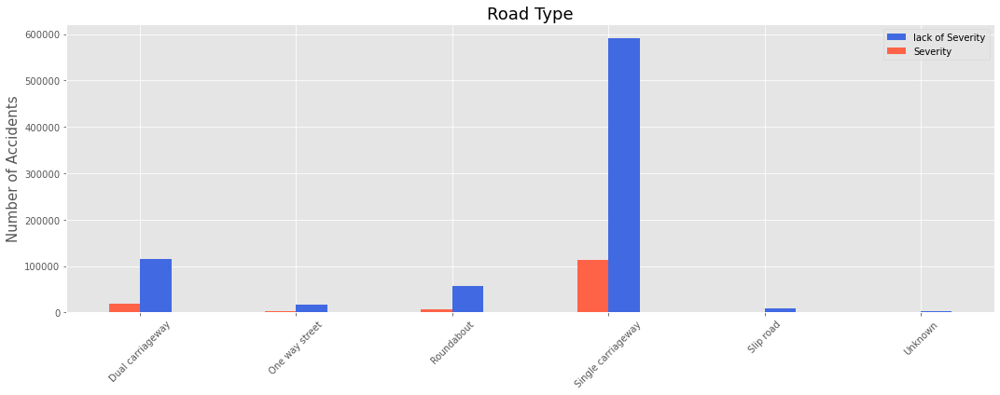

In [258]:
road_ty_0 = sev_0.groupby(['Road_Type'])['Accident_Index'].count().reset_index()

road_ty_1 = sev_1.groupby(['Road_Type'])['Accident_Index'].count().reset_index()

fig, ax = plt.subplots(1, figsize=(15, 6))
bar_width = 0.2
x1 = road_ty_0.iloc[:, 0]
x2 = road_ty_1.iloc[:,0]
y1 = road_ty_0.iloc[:,1]
y2 = road_ty_1.iloc[:,1]
ax.bar(x1, y1, color='royalblue', width=bar_width, align='edge', label='lack of Severity')
ax.bar(x2, y2, color='tomato', width=-bar_width, align='edge', label='Severity')
plt.xticks(rotation=45, fontsize=10, horizontalalignment='center')
ax.set_ylabel("Number of Accidents", fontsize=15)
ax.set_title("Road Type", fontsize=18)
fig.tight_layout()
ax.legend()

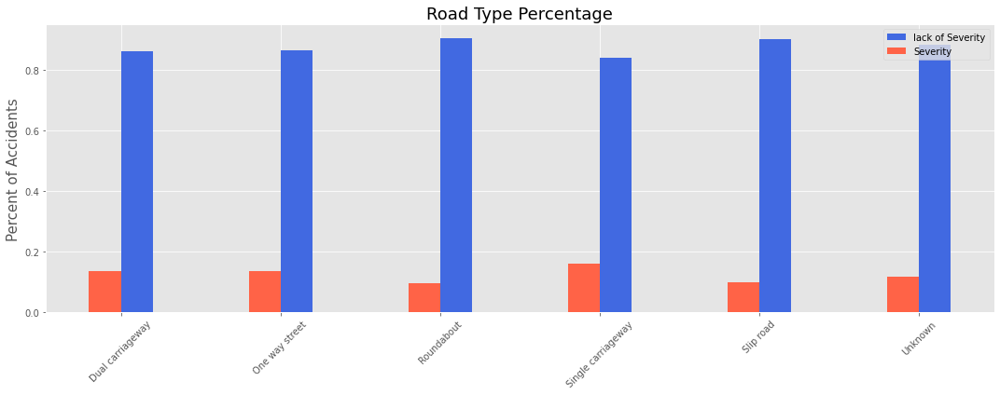

In [289]:
road_ty_0 = sev_0.groupby(['Road_Type'])['Accident_Index'].count().reset_index()

road_ty_1 = sev_1.groupby(['Road_Type'])['Accident_Index'].count().reset_index()

fig, ax = plt.subplots(1, figsize=(15, 6))
bar_width = 0.2
x1 = road_ty_0.iloc[:, 0]
x2 = road_ty_1.iloc[:,0]
y1 = road_ty_0.iloc[:,1]
y2 = road_ty_1.iloc[:,1]
ax.bar(x1, (y1/(y2+y1)), color='royalblue', width=bar_width, align='edge', label='lack of Severity')
ax.bar(x2, (y2/(y2+y1)), color='tomato', width=-bar_width, align='edge', label='Severity')
plt.xticks(rotation=45, fontsize=10, horizontalalignment='center')
ax.set_ylabel("Percent of Accidents", fontsize=15)
ax.set_title("Road Type Percentage", fontsize=18)
fig.tight_layout()
ax.legend()

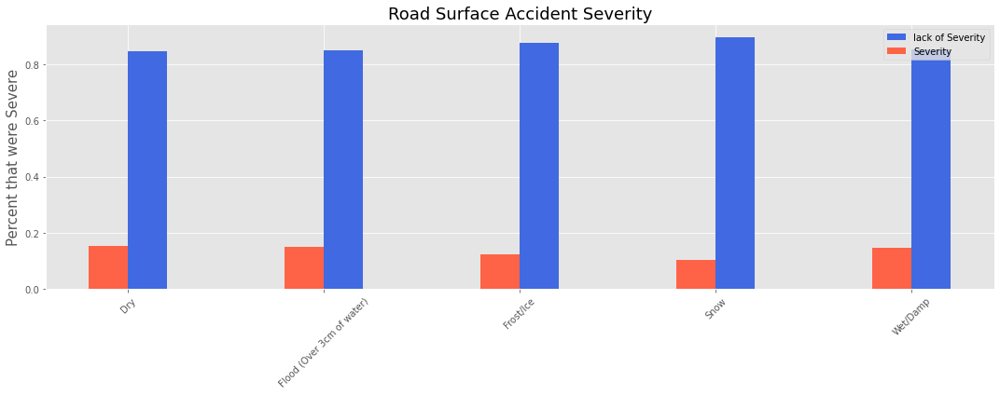

In [287]:
road_conditions_0 = sev_0.groupby(['Road_Surface_Conditions'])['Accident_Index'].count().reset_index()

road_conditions_1 = sev_1.groupby(['Road_Surface_Conditions'])['Accident_Index'].count().reset_index()

fig, ax = plt.subplots(1, figsize=(15, 6))
bar_width = 0.2
x1 = road_conditions_0.iloc[:, 0]
x2 = road_conditions_1.iloc[:,0]
y1 = road_conditions_0.iloc[:,1]
y2 = road_conditions_1.iloc[:,1]
ax.bar(x1,(y1/(y1+y2)), color='royalblue', width=bar_width, align='edge', label='lack of Severity')
ax.bar(x2, (y2/(y1+y2)), color='tomato', width=-bar_width, align='edge', label='Severity')
plt.xticks(rotation=45, fontsize=10, horizontalalignment='center')
ax.set_ylabel("Percent that were Severe", fontsize=15)
ax.set_title("Road Surface Accident Severity", fontsize=18)
fig.tight_layout()
ax.legend()

In [190]:
weather = df.groupby(['Number_of_Casualties'])['Accident_Index'].count().reset_index().sort_values('Accident_Index', ascending=False)


weather.head(50)

,Number_of_Casualties,Accident_Index
0,1,721643
1,2,146072
2,3,41998
3,4,15327
4,5,5531
5,6,2104
6,7,702
7,8,310
8,9,148
9,10,89


In [198]:
casualties_1__2 = df[(df['Number_of_Casualties'] >= 1) & (df['Number_of_Casualties'] <=2)]

casualties_3_ = df[(df['Number_of_Casualties'] >= 3)]



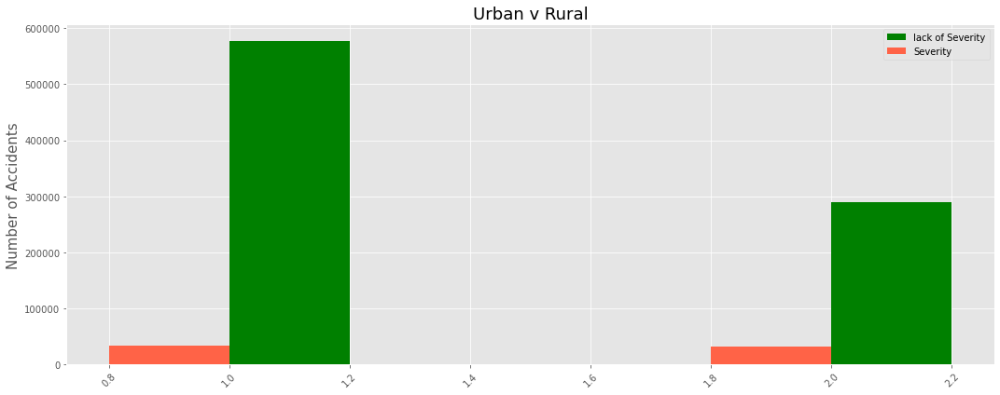

In [199]:
urb_0 = casualties_1__2.groupby('Urban_or_Rural_Area')['Accident_Index'].count().to_frame().reset_index()

urb_1 = casualties_3_.groupby('Urban_or_Rural_Area')['Accident_Index'].count().to_frame().reset_index()


fig, ax = plt.subplots(1, figsize=(15, 6))
bar_width = 0.2
x1 = urb_0.iloc[:, 0]
x2 = urb_1.iloc[:,0]
y1 = urb_0.iloc[:,1]
y2 = urb_1.iloc[:,1]
ax.bar(x1, y1, color='green', width=bar_width, align='edge', label='lack of Severity')
ax.bar(x2, y2, color='tomato', width=-bar_width, align='edge', label='Severity')
plt.xticks(rotation=45, fontsize=10, horizontalalignment='center')
ax.set_ylabel("Number of Accidents", fontsize=15)
ax.set_title("Urban v Rural", fontsize=18)
fig.tight_layout()
ax.legend()

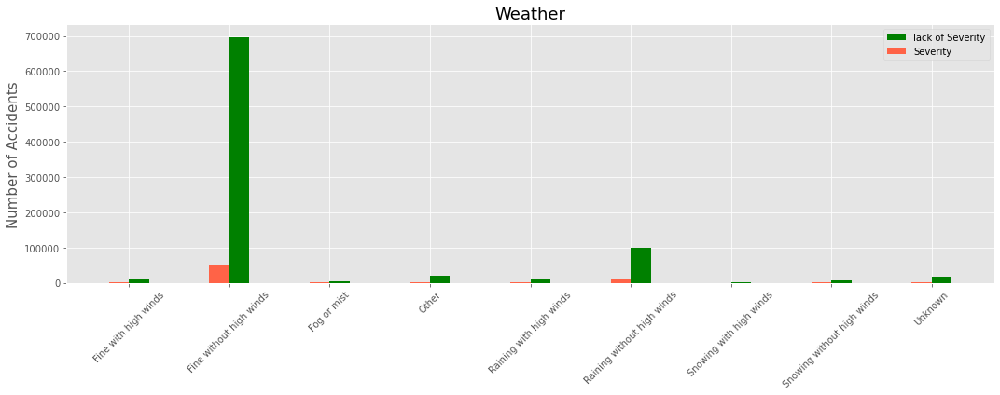

In [202]:
weather_0 = casualties_1__2.groupby(['Weather_Conditions'])['Accident_Index'].count().reset_index()

weather_1 = casualties_3_.groupby(['Weather_Conditions'])['Accident_Index'].count().reset_index()

fig, ax = plt.subplots(1, figsize=(15, 6))
bar_width = 0.2
x1 = weather_0.iloc[:, 0]
x2 = weather_1.iloc[:,0]
y1 = weather_0.iloc[:,1]
y2 = weather_1.iloc[:,1]
ax.bar(x1, y1, color='green', width=bar_width, align='edge', label='lack of Severity')
ax.bar(x2, y2, color='tomato', width=-bar_width, align='edge', label='Severity')
plt.xticks(rotation=45, fontsize=10, horizontalalignment='center')
ax.set_ylabel("Number of Accidents", fontsize=15)
ax.set_title("Weather", fontsize=18)
fig.tight_layout()
ax.legend()



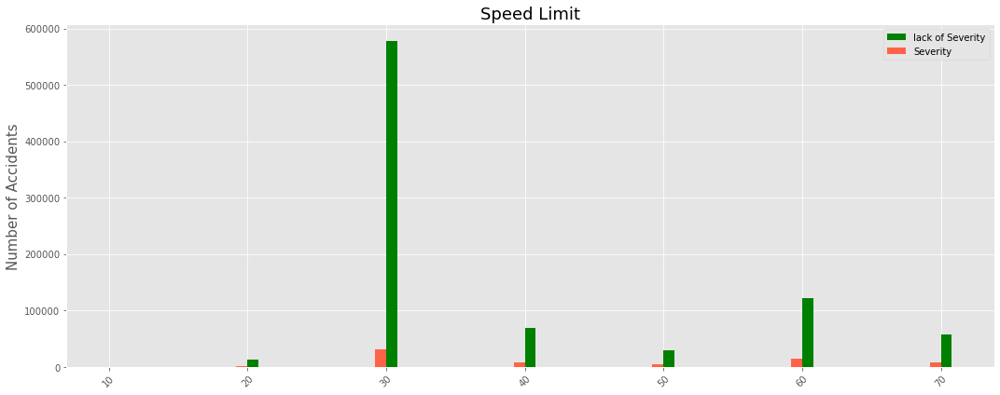

In [205]:
limit_0 = casualties_1__2.groupby(['Speed_limit'])['Accident_Index'].count().reset_index()

limit_1 = casualties_3_.groupby(['Speed_limit'])['Accident_Index'].count().reset_index()

fig, ax = plt.subplots(1, figsize=(15, 6))
bar_width = 0.8
x1 = limit_0.iloc[:, 0]
x2 = limit_1.iloc[:,0]
y1 = limit_0.iloc[:,1]
y2 = limit_1.iloc[:,1]
ax.bar(x1, y1, color='green', width=bar_width, align='edge', label='lack of Severity')
ax.bar(x2, y2, color='tomato', width=-bar_width, align='edge', label='Severity')
plt.xticks(rotation=45, fontsize=10, horizontalalignment='center')
ax.set_ylabel("Number of Accidents", fontsize=15)
ax.set_title("Speed Limit", fontsize=18)
fig.tight_layout()
ax.legend()

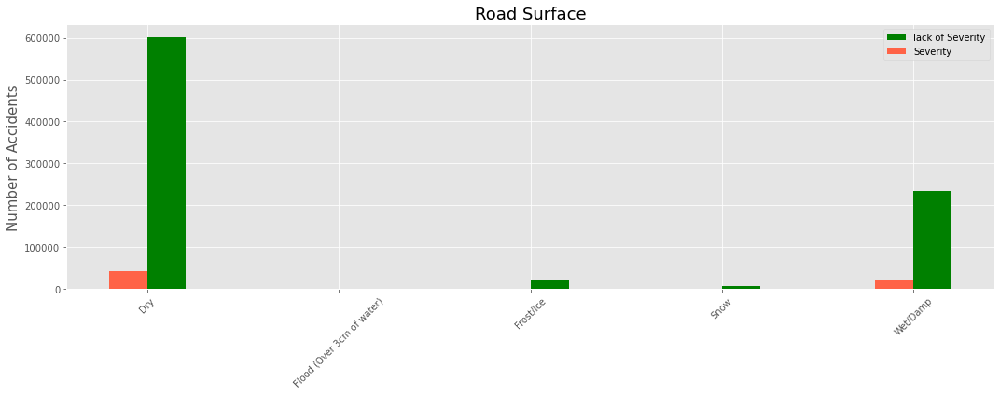

In [208]:
road_conditions_0 = casualties_1__2.groupby(['Road_Surface_Conditions'])['Accident_Index'].count().reset_index()

road_conditions_1 = casualties_3_.groupby(['Road_Surface_Conditions'])['Accident_Index'].count().reset_index()

fig, ax = plt.subplots(1, figsize=(15, 6))
bar_width = 0.2
x1 = road_conditions_0.iloc[:, 0]
x2 = road_conditions_1.iloc[:,0]
y1 = road_conditions_0.iloc[:,1]
y2 = road_conditions_1.iloc[:,1]
ax.bar(x1, y1, color='green', width=bar_width, align='edge', label='lack of Severity')
ax.bar(x2, y2, color='tomato', width=-bar_width, align='edge', label='Severity')
plt.xticks(rotation=45, fontsize=10, horizontalalignment='center')
ax.set_ylabel("Number of Accidents", fontsize=15)
ax.set_title("Road Surface", fontsize=18)
fig.tight_layout()
ax.legend()

In [ ]:
df['Hour_of_Day'] = df['Time'].str[:2]



### Logistic Attemps

In [140]:

from statsmodels.tools import add_constant
from statsmodels.discrete.discrete_model import Logit

from sklearn.datasets import make_classification
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import KFold, train_test_split
from sklearn.metrics import accuracy_score, precision_score, recall_score

In [250]:
X = accident_df[[ 'Urban_or_Rural_Area', 'Speed_limit']].values
X_const = add_constant(X, prepend=True)
## X_const???
y = accident_df['Accident_Severity'].values

logit_model = Logit(y, X_const).fit()

Optimization terminated successfully.
         Current function value: 0.421826
         Iterations 6


In [251]:
print(logit_model.summary2())

                          Results: Logit
Model:              Logit            Pseudo R-squared: 0.006      
Dependent Variable: y                AIC:              788094.0024
Date:               2020-11-30 14:21 BIC:              788129.2445
No. Observations:   934139           Log-Likelihood:   -3.9404e+05
Df Model:           2                LL-Null:          -3.9655e+05
Df Residuals:       934136           LLR p-value:      0.0000     
Converged:          1.0000           Scale:            1.0000     
No. Iterations:     6.0000                                        
--------------------------------------------------------------------
          Coef.    Std.Err.       z       P>|z|     [0.025    0.975]
--------------------------------------------------------------------
const    -2.3444     0.0093   -251.7812   0.0000   -2.3626   -2.3261
x1        0.2971     0.0081     36.7521   0.0000    0.2813    0.3130
x2        0.0053     0.0003     19.6217   0.0000    0.0048    0.0058



In [252]:
from sklearn.linear_model import LogisticRegression
from sklearn import metrics
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=0)
logreg = LogisticRegression()
logreg.fit(X_train, y_train)

LogisticRegression()

In [253]:
y_pred = logreg.predict(X_test)
print('Accuracy of logistic regression classifier on test set: {:.2f}'.format(logreg.score(X_test, y_test)))

Accuracy of logistic regression classifier on test set: 0.85


In [254]:
from sklearn.metrics import confusion_matrix
confusion_matrix = confusion_matrix(y_test, y_pred)
print(confusion_matrix)

[[238162      0]
 [ 42080      0]]


In [146]:
# kfold = KFold(n_splits=10)

# accuracies = []
# precisions = []
# recalls = []

# X_train, X_test, y_train, y_test = train_test_split(X, y)

# for train_index, test_index in kfold.split(X_train):
#     model = LogisticRegression(solver="lbfgs")
#     model.fit(X_train[train_index], y_train[train_index])
#     y_predict = model.predict(X_train[test_index])
#     y_true = y_train[test_index]
#     accuracies.append(accuracy_score(y_true, y_predict))
#     precisions.append(precision_score(y_true, y_predict))
#     recalls.append(recall_score(y_true, y_predict))

# print("Accuracy:", np.average(accuracies))
# print("Precision:", np.average(precisions))
# print("Recall:", np.average(recalls))

In [152]:
model = LogisticRegression(solver='lbfgs')
model.fit(X, y)

print(model.coef_[0])

[0.00201999 0.27510828 0.00508804]


In [ ]:
# model = LogisticRegression(solver='lbfgs')
# model.fit(X, y)

# for name, coef in zip(df.columns[1:], model.coef_[0]):
#     print("{0}: {1:0.4f}".format(name, coef))

In [156]:
print(accident_df.columns[1:])

Index(['Location_Easting_OSGR', 'Location_Northing_OSGR', 'Longitude',
       'Latitude', 'Police_Force', 'Accident_Severity', 'Number_of_Vehicles',
       'Number_of_Casualties', 'Date', 'Day_of_Week', 'Time',
       'Local_Authority_(District)', 'Local_Authority_(Highway)',
       '1st_Road_Class', '1st_Road_Number', 'Road_Type', 'Speed_limit',
       'Junction_Detail', 'Junction_Control', '2nd_Road_Class',
       '2nd_Road_Number', 'Pedestrian_Crossing-Human_Control',
       'Pedestrian_Crossing-Physical_Facilities', 'Light_Conditions',
       'Weather_Conditions', 'Road_Surface_Conditions',
       'Special_Conditions_at_Site', 'Carriageway_Hazards',
       'Urban_or_Rural_Area', 'Did_Police_Officer_Attend_Scene_of_Accident',
       'LSOA_of_Accident_Location', 'Year'],
      dtype='object')


In [154]:
for i, coef in enumerate(model.coef_[0]):
    print("beta{0}: {1:0.5f}".format(i + 1, np.exp(coef)))

beta1: 1.00202
beta2: 1.31667
beta3: 1.00510


##### Increasing the Police_Force score by 1 point increases the chance of accident being severve by a factor of 1.00189.

##### Increasing the Urban_Rural score by 1 point increases the chance of accident being severve by a factor of 1.37614

##### Increasing the Speed_limit score by 1 point increases the chance of accident being severve by a factor of 1.00510


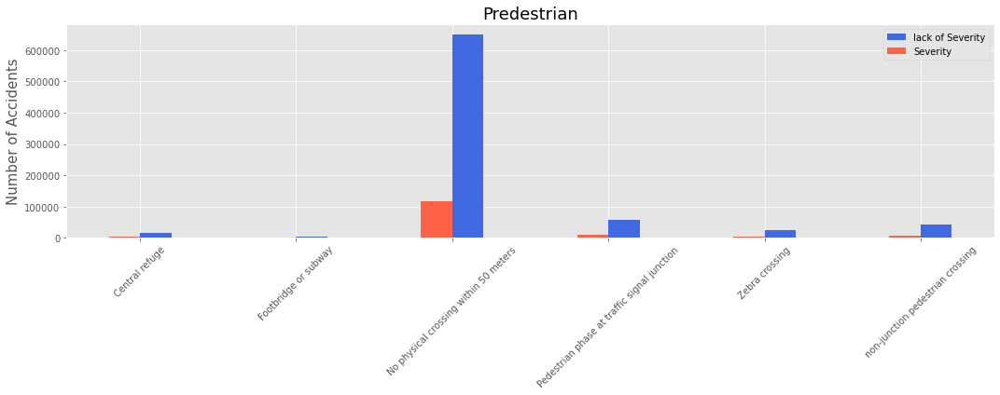

In [259]:
ped_0 = sev_0.groupby(['Pedestrian_Crossing-Physical_Facilities'])['Accident_Index'].count().reset_index()

ped_1 = sev_1.groupby(['Pedestrian_Crossing-Physical_Facilities'])['Accident_Index'].count().reset_index()

fig, ax = plt.subplots(1, figsize=(15, 6))
bar_width = 0.2
x1 = ped_0.iloc[:, 0]
x2 = ped_1.iloc[:,0]
y1 = ped_0.iloc[:,1]
y2 = ped_1.iloc[:,1]
ax.bar(x1, y1, color='royalblue', width=bar_width, align='edge', label='lack of Severity')
ax.bar(x2, y2, color='tomato', width=-bar_width, align='edge', label='Severity')
plt.xticks(rotation=45, fontsize=10, horizontalalignment='center')
ax.set_ylabel("Number of Accidents", fontsize=15)
ax.set_title("Predestrian", fontsize=18)
fig.tight_layout()
ax.legend()

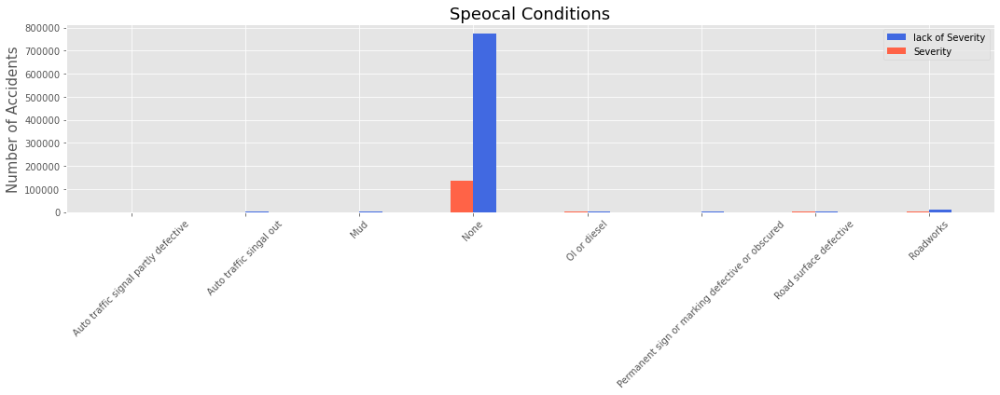

In [260]:
spec_0 = sev_0.groupby(['Special_Conditions_at_Site'])['Accident_Index'].count().reset_index()

spec_1 = sev_1.groupby(['Special_Conditions_at_Site'])['Accident_Index'].count().reset_index()

fig, ax = plt.subplots(1, figsize=(15, 6))
bar_width = 0.2
x1 = spec_0.iloc[:, 0]
x2 = spec_1.iloc[:,0]
y1 = spec_0.iloc[:,1]
y2 = spec_1.iloc[:,1]
ax.bar(x1, y1, color='royalblue', width=bar_width, align='edge', label='lack of Severity')
ax.bar(x2, y2, color='tomato', width=-bar_width, align='edge', label='Severity')
plt.xticks(rotation=45, fontsize=10, horizontalalignment='center')
ax.set_ylabel("Number of Accidents", fontsize=15)
ax.set_title("Speocal Conditions", fontsize=18)
fig.tight_layout()
ax.legend()

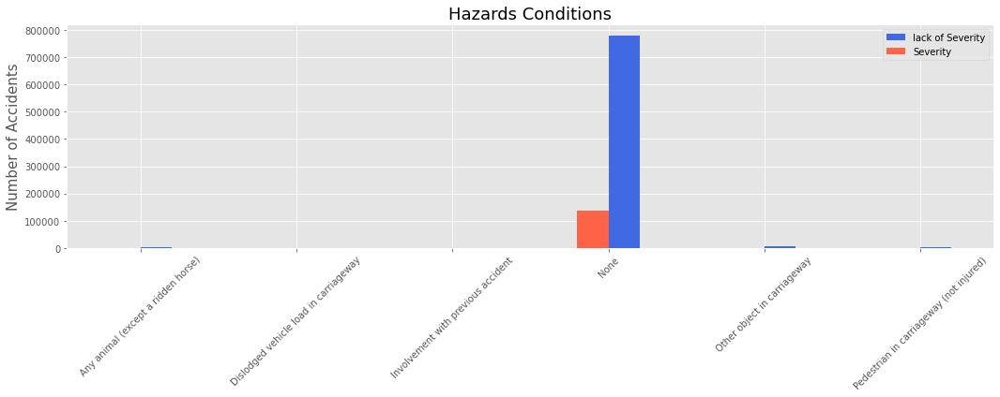

In [261]:
haz_0 = sev_0.groupby(['Carriageway_Hazards'])['Accident_Index'].count().reset_index()

haz_1 = sev_1.groupby(['Carriageway_Hazards'])['Accident_Index'].count().reset_index()

fig, ax = plt.subplots(1, figsize=(15, 6))
bar_width = 0.2
x1 = haz_0.iloc[:, 0]
x2 = haz_1.iloc[:,0]
y1 = haz_0.iloc[:,1]
y2 = haz_1.iloc[:,1]
ax.bar(x1, y1, color='royalblue', width=bar_width, align='edge', label='lack of Severity')
ax.bar(x2, y2, color='tomato', width=-bar_width, align='edge', label='Severity')
plt.xticks(rotation=45, fontsize=10, horizontalalignment='center')
ax.set_ylabel("Number of Accidents", fontsize=15)
ax.set_title("Hazards Conditions", fontsize=18)
fig.tight_layout()
ax.legend()

<function matplotlib.pyplot.show(close=None, block=None)>

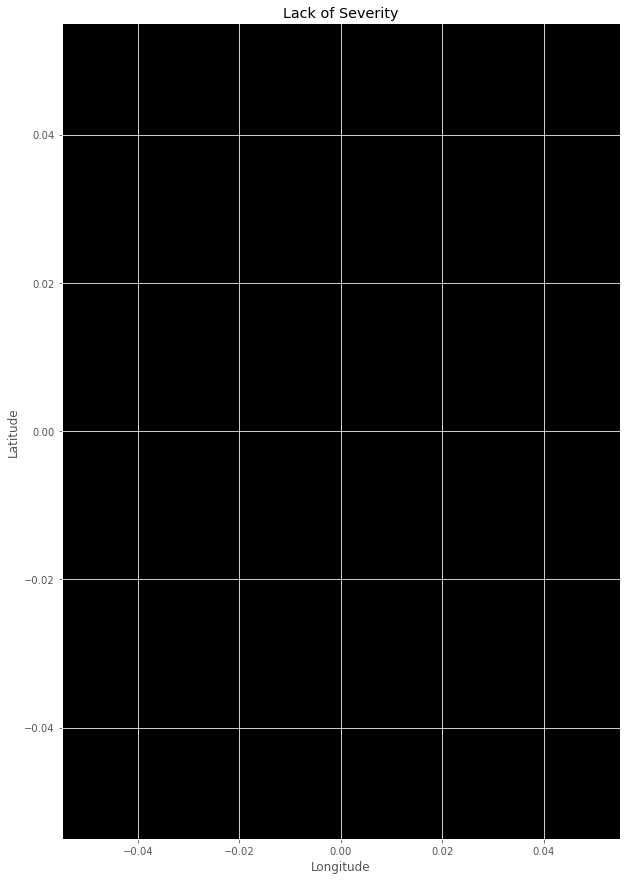

In [285]:
level = accident_df[accident_df['Urban_or_Rural_Area'] == 0]

fig, ax = plt.subplots(1, figsize=(10,15))
level.plot(kind='scatter', x='Longitude',y ='Latitude',
                color='red', 
                s=.1, alpha=.8, subplots=True, ax=ax)
ax.set_title("Lack of Severity")
ax.set_facecolor('black');

plt.show

<function matplotlib.pyplot.show(close=None, block=None)>

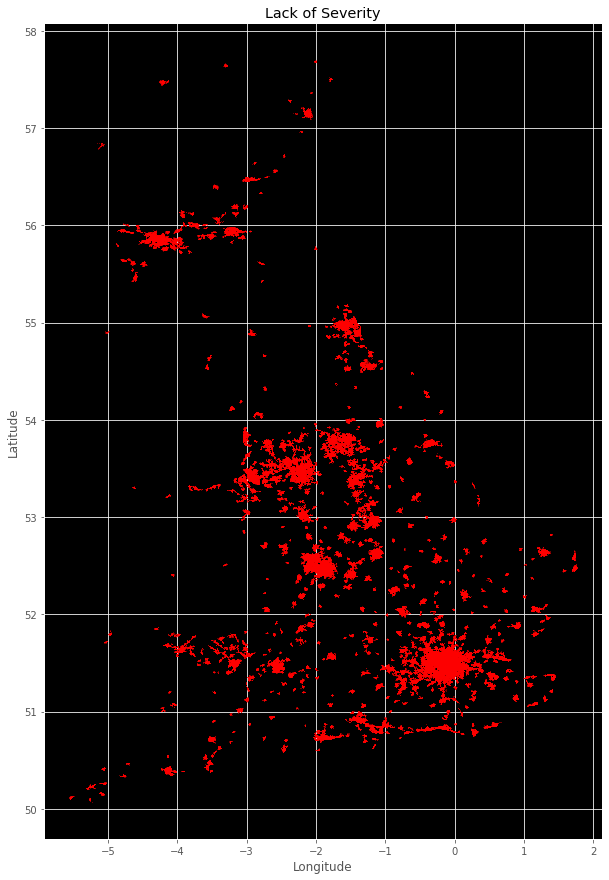

In [286]:
level_ = accident_df[accident_df['Urban_or_Rural_Area'] == 1]

fig, ax = plt.subplots(1, figsize=(10,15))
level_.plot(kind='scatter', x='Longitude',y ='Latitude',
                color='red', 
                s=.1, alpha=.8, subplots=True, ax=ax)
ax.set_title("Lack of Severity")
ax.set_facecolor('black');

plt.show